# 0 准备工作

In [1]:
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision
import torchvision.transforms as transforms
from torch.utils.data import Dataset, DataLoader, WeightedRandomSampler
from torch.utils.tensorboard import SummaryWriter
import matplotlib.pyplot as plt
import numpy as np
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import random
import seaborn as sns
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, classification_report
import cv2
from PIL import Image
from pathlib import Path
from torchvision.transforms import functional as F
import torch.nn.functional as F
from tqdm import tqdm
import time
from torchsummary import summary
import os
from google.colab import drive
from collections import Counter

In [2]:
seed = 3407
torch.manual_seed(seed)  # PyTorch CPU 的随机种子
torch.cuda.manual_seed(seed)  # PyTorch GPU 的随机种子
np.random.seed(seed)  # Numpy 的随机种子
random.seed(seed)

In [3]:
drive.mount('/content/drive')

Mounted at /content/drive


In [4]:
def show(img1, camp1, img2, camp2):
  plt.figure(figsize=(12, 6))

  plt.subplot(1, 2, 1)
  plt.imshow(img1, cmap=camp1)
  plt.axis('off')

  plt.subplot(1, 2, 2)
  plt.imshow(img2, cmap=camp2)
  plt.axis('off')

  plt.show()

# **1 引言**

&emsp;&emsp;实时车牌识别系统（Automatic License Plate Recognition, ALPR）在现代交通管理、城市安全以及智能交通系统中扮演着重要的角色，其技术涉及机器学习、图像处理等多个领域。<br>
&emsp;&emsp;本次实验采用 ***CCPD*** 数据集，数据集中所有车牌均为新能源(绿白渐变车牌)车牌。<br>
&emsp;&emsp;这是一个用于车牌识别的大型国内停车场车牌数据集——CCPD(Chinese City Parking Dataset)，数据集主要在合肥市的停车场采集得来，采集时间早上7:30到晚上10:00，手工标注车牌位置。 拍摄的车牌照片涉及多种复杂环境，包括模糊、倾斜、阴雨天、雪天等等。<br><br>


**下面进行数据的读取：**

#### 读取原始数据

In [5]:
train_img, train_label = [], []
test_img, test_label = [], []
val_img, val_label = [], []

In [6]:
train_dir = '/content/drive/MyDrive/ALPR/train'
test_dir = '/content/drive/MyDrive/ALPR/test'
val_dir = '/content/drive/MyDrive/ALPR/val'

In [7]:
def load_data(dir, img_list, label_list):
  for filename in os.listdir(dir):
    if filename.endswith('.jpg'):
      img_path = os.path.join(dir, filename)
      img = cv2.imread(img_path)
      img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
      img_list.append(img_rgb)
      label_list.append(filename)

# 训练集
load_data(train_dir, train_img, train_label)
# 验证集
load_data(test_dir, test_img, test_label)
# 测试集
load_data(val_dir, val_img, val_label)

#### 正确车牌区域
读取正确的车牌相关信息（包括车牌正确的四个标准点），

后续用于**与定位的车牌位置做比较评估**和**进行透视变换做下一步车牌内容识别部分**。

In [12]:
def get_rotate_crop_image(img, points):
  # 计算裁剪图像的宽度和高度
  img_crop_width = int(
      max(
          np.linalg.norm(points[0] - points[1]),
          np.linalg.norm(points[2] - points[3])))

  img_crop_height = int(
      max(
          np.linalg.norm(points[0] - points[3]),
          np.linalg.norm(points[1] - points[2])))

  # 创建标准的四个顶点坐标
  pts_std = np.float32([[0, 0], [img_crop_width, 0], [img_crop_width, img_crop_height], [0, img_crop_height]])
  M = cv2.getPerspectiveTransform(points, pts_std)

  # 执行透视变换
  dst_img = cv2.warpPerspective(
        img,
        M, (img_crop_width, img_crop_height),
        borderMode=cv2.BORDER_REPLICATE,
        flags=cv2.INTER_CUBIC)

  dst_img_height, dst_img_width = dst_img.shape[0:2]
  # 如果高度大于宽度的1.5倍，旋转90度
  if dst_img_height * 1.0 / dst_img_width >= 1.5:
    dst_img = np.rot90(dst_img)

  # 将图像转换为灰度图
  gray_img = cv2.cvtColor(dst_img, cv2.COLOR_BGR2GRAY)

  # 二值模糊（Gaussian模糊）
  blurred_img = cv2.GaussianBlur(gray_img, (3, 3), 0)

  # 直方图均衡化
  equalized_img = cv2.equalizeHist(blurred_img)

  # 应用二值化（反转黑白）
  _, binary_img = cv2.threshold(equalized_img, 60, 255, cv2.THRESH_BINARY_INV)

  # 膨胀操作 + 开运算（去除小噪声）
  kernel = np.ones((3, 3), np.uint8)
  dilated_img = cv2.dilate(binary_img, kernel, iterations=1)
  result = cv2.morphologyEx(dilated_img, cv2.MORPH_OPEN, kernel)

  return result

In [13]:
provinces = ["皖", "沪", "津", "渝", "冀", "晋", "蒙", "辽", "吉", "黑", "苏", "浙", "京", "闽", "赣", "鲁", "豫", "鄂", "湘", "粤", "桂", "琼", "川", "贵", "云", "藏", "陕", "甘", "青", "宁", "新", "警", "学", "O"]
alphabets = ['A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'J', 'K', 'L', 'M', 'N', 'P', 'Q', 'R', 'S', 'T', 'U', 'V', 'W', 'X', 'Y', 'Z', 'O']
ads = ['A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'J', 'K', 'L', 'M', 'N', 'P', 'Q', 'R', 'S', 'T', 'U', 'V', 'W', 'X', 'Y', 'Z', '0', '1', '2', '3', '4', '5', '6', '7', '8', '9', 'O']

License Plate: 皖AD07697


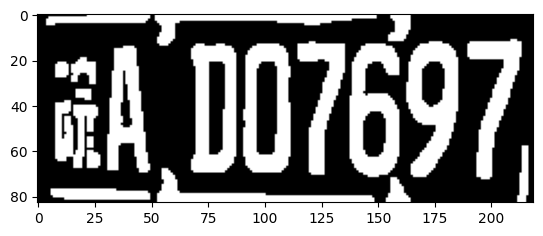

License Plate: 皖ADT1171


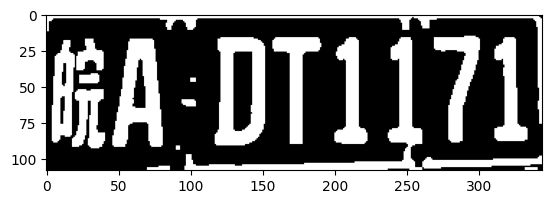

License Plate: 皖AD03911


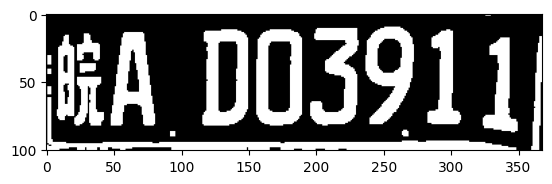

License Plate: 皖AD10886


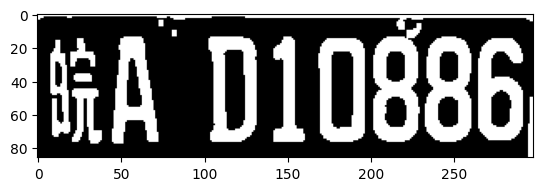

In [14]:
# 存储裁剪后的车牌图像和车牌号
true_train_img = []
true_train_license_plate_numbers = []
true_train_boxes = []
true_val_img = []
true_val_license_plate_numbers = []
true_val_boxes = []
true_test_img = []
true_test_license_plate_numbers = []
true_test_boxes = []

# 遍历 train_img 和 train_label，处理车牌区域
for i, (img, label_path) in enumerate(zip(train_img, train_label)):
  if i in train_lost_indices:  # 如果是丢失的训练集图片，跳过
    continue
  filename = os.path.basename(label_path)
  str_list = filename.split('-')
  if len(str_list) < 5:
    continue  # 文件名格式不正确，跳过

  # 解析坐标和车牌号码
  coord_list = str_list[3].split('_')
  txt_list = str_list[4].split('_')
  boxes = []
  for coord in coord_list:
    boxes.append([int(x) for x in coord.split("&")])
  boxes = [boxes[2], boxes[3], boxes[0], boxes[1]]  # 左上、右上、右下、左下顺序
  true_train_boxes.append(boxes)

  # 车牌号码解析
  lp_number = provinces[int(txt_list[0])] + alphabets[int(txt_list[1])] + ''.join([ads[int(x)] for x in txt_list[2:]])

  # 获取裁剪图像
  crop_img = get_rotate_crop_image(img, np.float32(boxes))  # 使用透视变换裁剪图像

  # 保存裁剪后的车牌图像和车牌号
  true_train_img.append(crop_img)
  true_train_license_plate_numbers.append(lp_number)

# 处理验证集
for i, (img, label_path) in enumerate(zip(val_img, val_label)):
  if i in val_lost_indices:  # 如果是丢失的验证集图片，跳过
    continue
  filename = os.path.basename(label_path)
  str_list = filename.split('-')
  if len(str_list) < 5:
    continue
  coord_list = str_list[3].split('_')
  txt_list = str_list[4].split('_')
  boxes = []
  for coord in coord_list:
    boxes.append([int(x) for x in coord.split("&")])
  boxes = [boxes[2], boxes[3], boxes[0], boxes[1]]
  true_val_boxes.append(boxes)
  lp_number = provinces[int(txt_list[0])] + alphabets[int(txt_list[1])] + ''.join([ads[int(x)] for x in txt_list[2:]])
  crop_img = get_rotate_crop_image(img, np.float32(boxes))
  true_val_img.append(crop_img)
  true_val_license_plate_numbers.append(lp_number)

# 处理测试集
for i, (img, label_path) in enumerate(zip(test_img, test_label)):
  if i in test_lost_indices:  # 如果是丢失的测试集图片，跳过
    continue
  filename = os.path.basename(label_path)
  str_list = filename.split('-')
  if len(str_list) < 5:
    continue
  coord_list = str_list[3].split('_')
  txt_list = str_list[4].split('_')
  boxes = []
  for coord in coord_list:
    boxes.append([int(x) for x in coord.split("&")])
  boxes = [boxes[2], boxes[3], boxes[0], boxes[1]]
  true_test_boxes.append(boxes)
  lp_number = provinces[int(txt_list[0])] + alphabets[int(txt_list[1])] + ''.join([ads[int(x)] for x in txt_list[2:]])
  crop_img = get_rotate_crop_image(img, np.float32(boxes))
  true_test_img.append(crop_img)
  true_test_license_plate_numbers.append(lp_number)

# 输出结果
i = 0
for crop_img, lp_number in zip(true_train_img, true_train_license_plate_numbers):
  print(f"License Plate: {lp_number}")
  plt.imshow(crop_img, "gray")
  plt.show()
  i = i + 1
  if i == 4:
    break

# **2 车牌区域检测**

## **2.1 图像处理**

### 2.1.1 明暗处理

&emsp;&emsp;室外采集的车辆图像，易受天气多变、环境复杂影响，使得图像中经常出现某些区域亮度较强，某些区域亮度则不足，图像整体亮度呈现不均匀的现象，导致图像质量不佳，重要的细节信息无法显现。<br>
&emsp;&emsp;**该部分的操作是尝试复现2021年兰州交通大学的一篇硕士论文$^{[1]}$中的光照补偿部分**，根据对后续操作的可视化结果的观察，该方法的结果较直方图均衡化而言要好一些。
<br><br>

**$[1]$苏春燕.复杂环境下综合多种特征的车牌定位算法研究[D].兰州交通大学,2021.DOI:10.27205/d.cnki.gltec.2021.000236.**


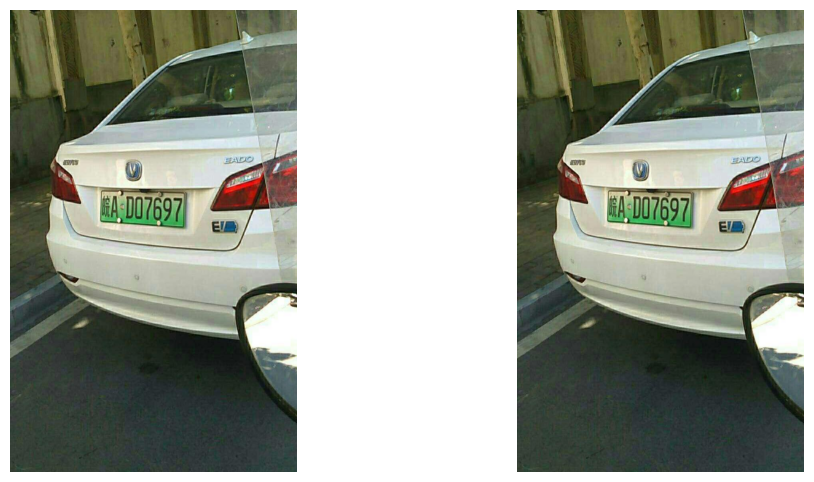

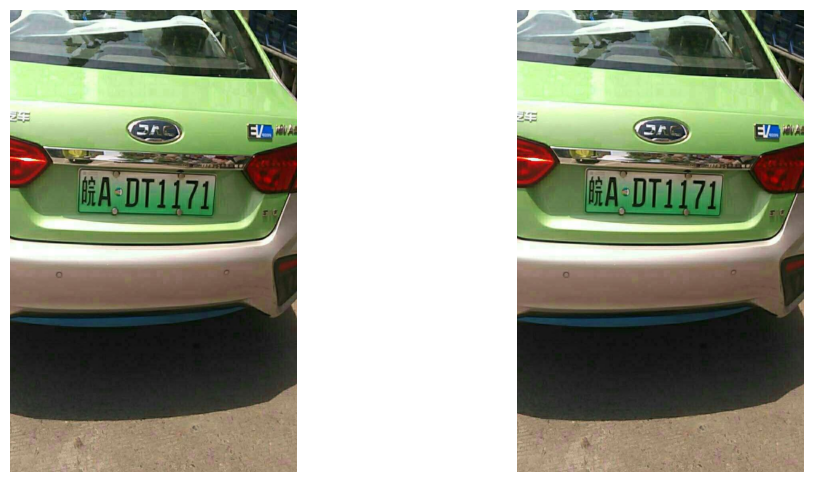

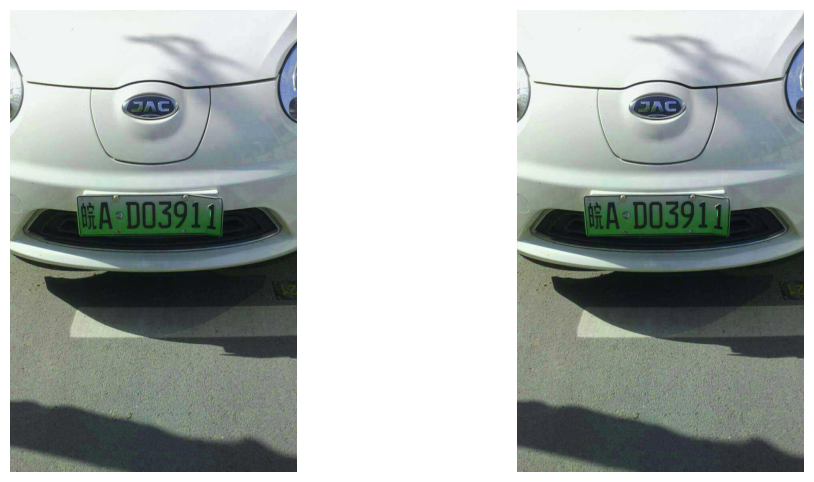

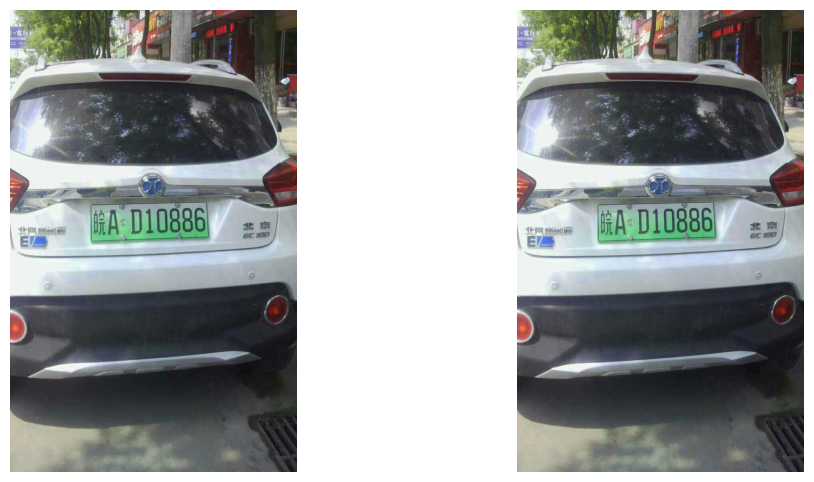

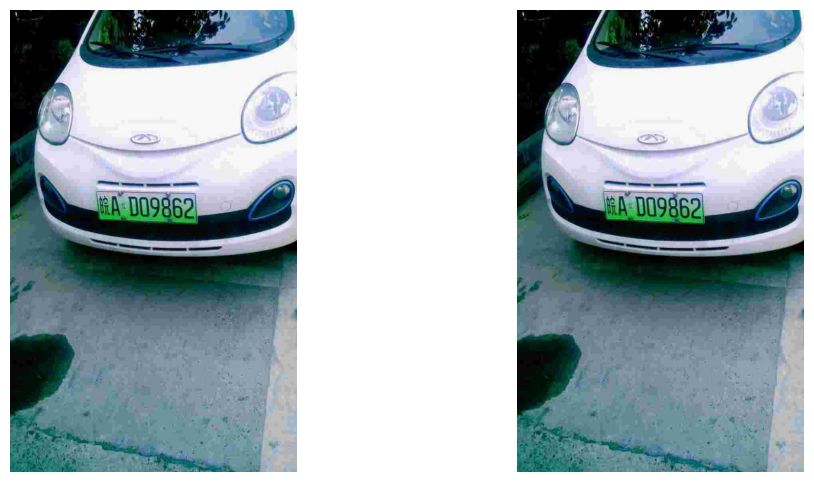

In [8]:
def apply_lighting_correction(img):
  """
  对输入图像进行光照校正并返回校正后的图像。
  """
  # 将图像从RGB空间转换为HSV空间
  hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
  h, s, v = cv2.split(hsv)

  # 定义不同尺度因子和加权系数
  scales = [1 / 15, 2 / 80, 3 / 250]  # 尺度因子
  weights = [1 / 3, 2 / 3, 3 / 3]  # 加权系数

  # 计算光照分量
  lighting_components = []
  for scale in scales:
    ksize = int(6 * scale) + 1  # 根据尺度因子确定卷积核大小
    gaussian_kernel = cv2.getGaussianKernel(ksize, scale)
    gaussian_kernel = gaussian_kernel @ gaussian_kernel.T  # 转换为二维高斯核
    lighting_component = cv2.filter2D(v, -1, gaussian_kernel)  # 卷积
    lighting_components.append(lighting_component)

  # 加权合成光照分量
  I = np.zeros_like(v, dtype=np.float32)
  for i, lighting_component in enumerate(lighting_components):
    I += weights[i] * lighting_component

  # 计算 gamma 值并进行亮度校正
  gamma = 1 / (I.mean() + 1e-6)  # 防止除零
  gamma = np.clip(gamma, 1, 5)  # 限制 gamma 范围
  m = 255 * gamma  # 亮度均值
  O = np.clip((v / 255) ** gamma * m, 0, 255)  # Gamma 校正

  # 合并 HSV 分量，并将图像转换回 RGB
  hsv_corrected = cv2.merge([h, s, O.astype(np.uint8)])
  img_corrected = cv2.cvtColor(hsv_corrected, cv2.COLOR_HSV2RGB)

  return img_corrected

def process_images(image_list, output_list, display_count=0):
  """
  对一组图像进行光照校正处理，并存储在输出列表中。
  可以选择显示部分处理结果。
  """
  for index, img in enumerate(image_list):
    img_corrected = apply_lighting_correction(img)
    output_list.append(img_corrected)

    # 显示部分处理结果
    if index < display_count:
      show(img, None, img_corrected, None)

v_train_img, v_val_img, v_test_img = [], [], []

process_images(train_img, v_train_img, display_count=5)
process_images(val_img, v_val_img)
process_images(test_img, v_test_img)

### 2.1.2 颜色分割

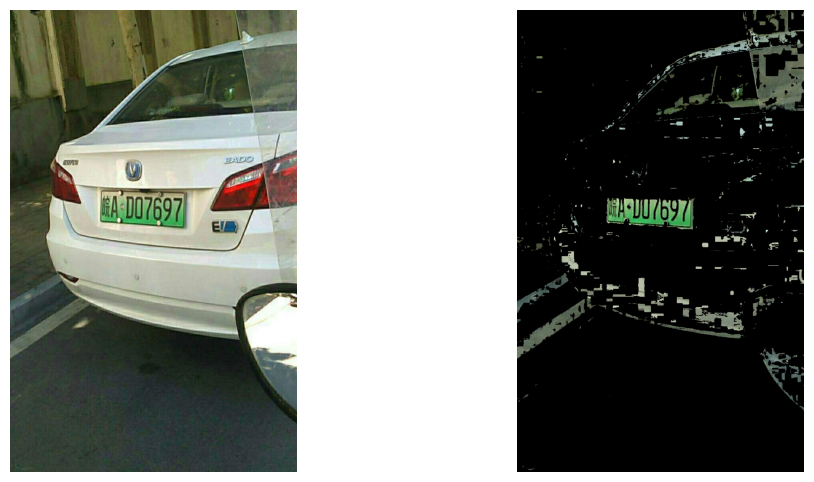

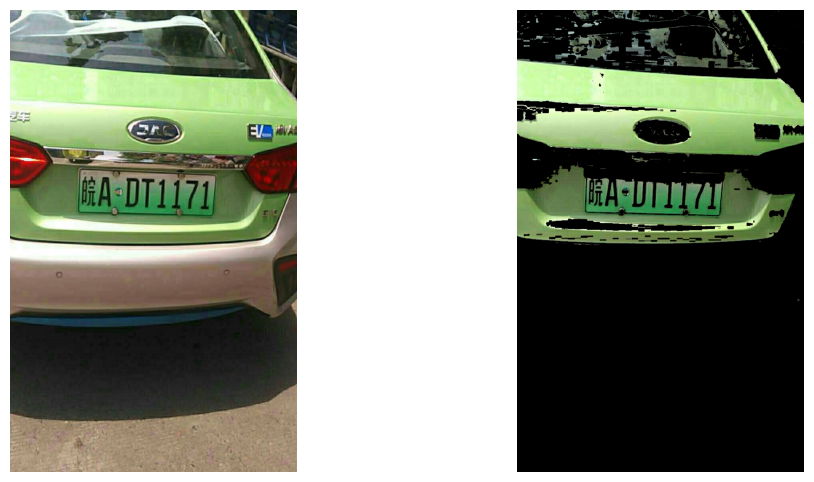

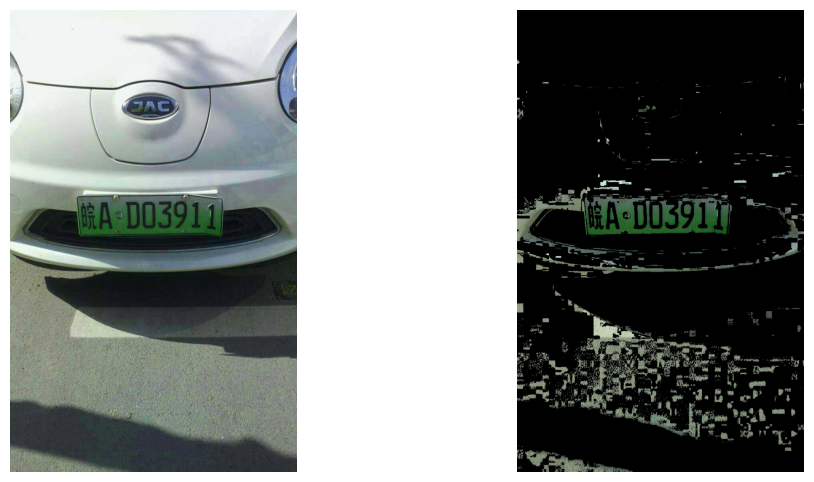

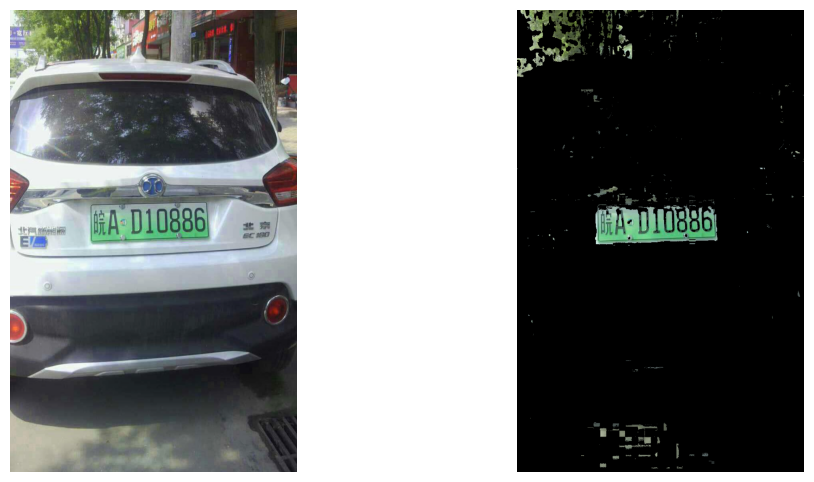

In [9]:
def extract_green_region(image_list, output_list, lower_bound, upper_bound, display_count=0):
  """
  从图像中提取绿色区域，并存储到输出列表中。

  参数:
      image_list (list): 输入图像列表。
      output_list (list): 输出存储提取结果的列表。
      lower_bound (numpy.array): HSV下界，用于绿色检测。
      upper_bound (numpy.array): HSV上界，用于绿色检测。
      display_count (int): 显示处理结果的图像数量（用于调试）。
  """
  for index, img in enumerate(image_list):
    # 转换为HSV空间
    hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)

    # 创建绿色区域的掩膜
    mask = cv2.inRange(hsv, lower_bound, upper_bound)

    # 提取绿色区域
    green_region = cv2.bitwise_and(img, img, mask=mask)

    # 保存处理结果
    output_list.append(green_region)

    # 显示部分处理结果
    if index < display_count:
      show(img, None, green_region, None)

lower_green = np.array([40, 30, 80])  # 下界
upper_green = np.array([90, 255, 255])  # 上界

green_train_img, green_val_img, green_test_img = [], [], []

extract_green_region(v_train_img, green_train_img, lower_green, upper_green, display_count=4)
extract_green_region(v_val_img, green_val_img, lower_green, upper_green)
extract_green_region(v_test_img, green_test_img, lower_green, upper_green)

### 2.1.3 边缘检测 + 形态学操作

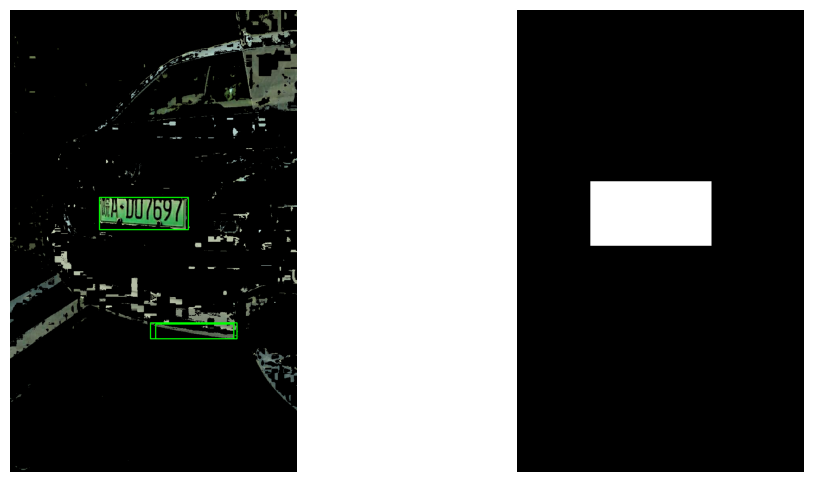

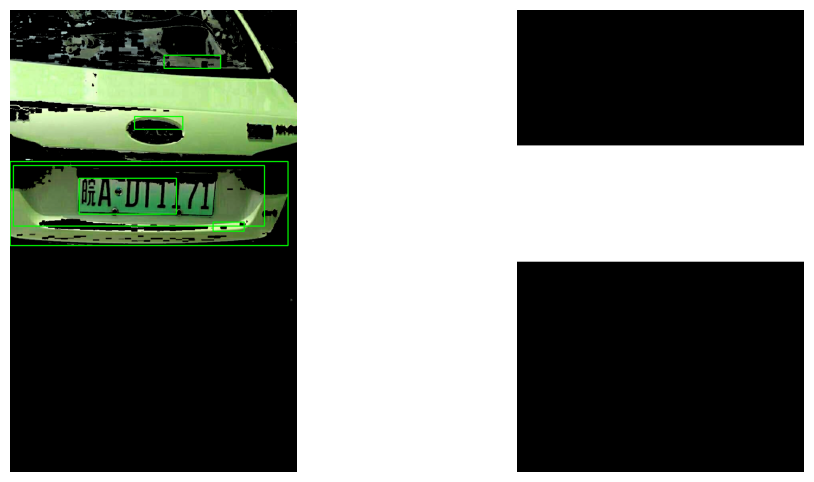

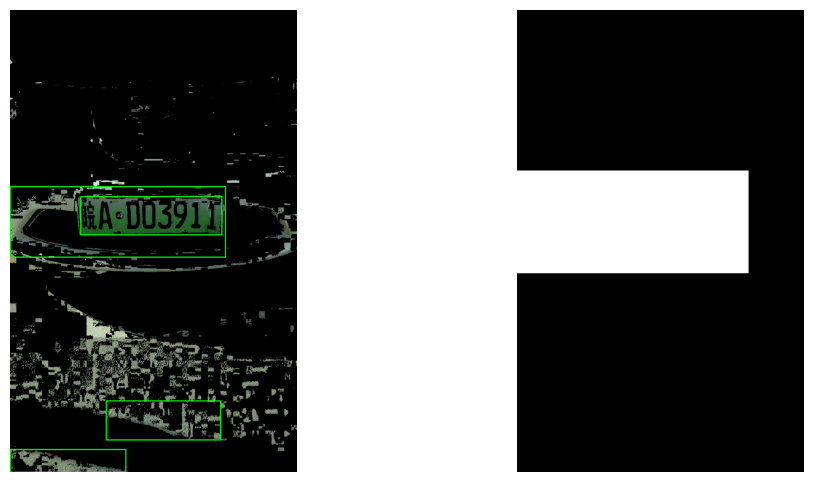

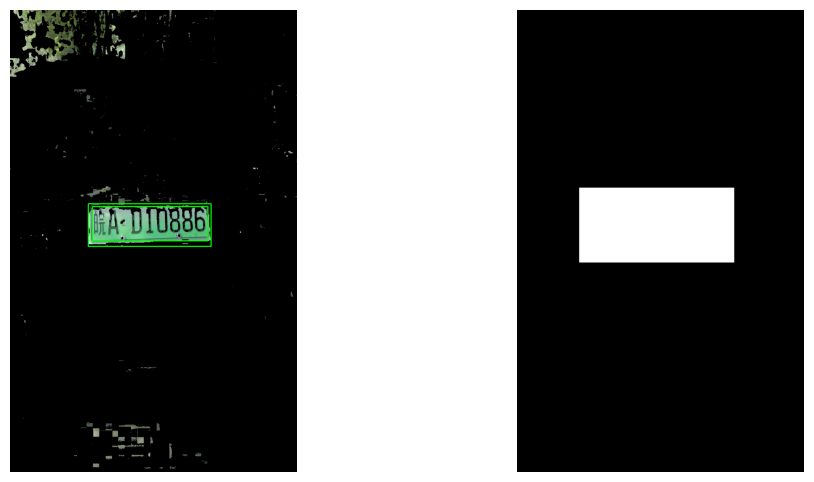

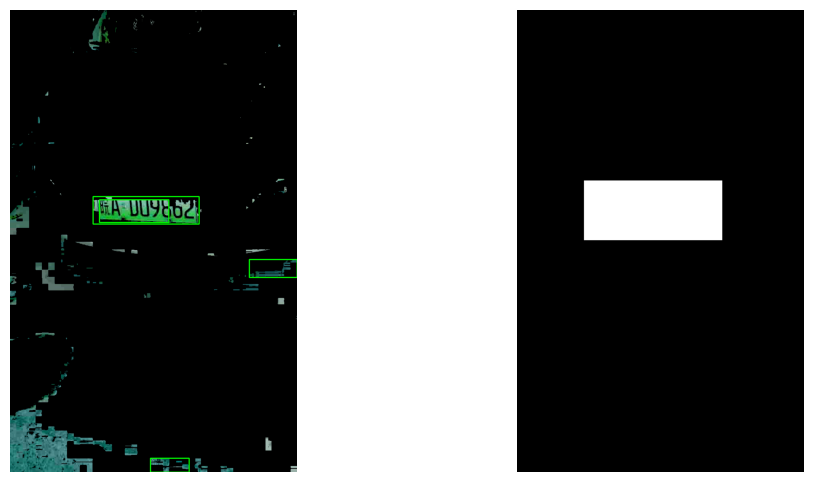

...

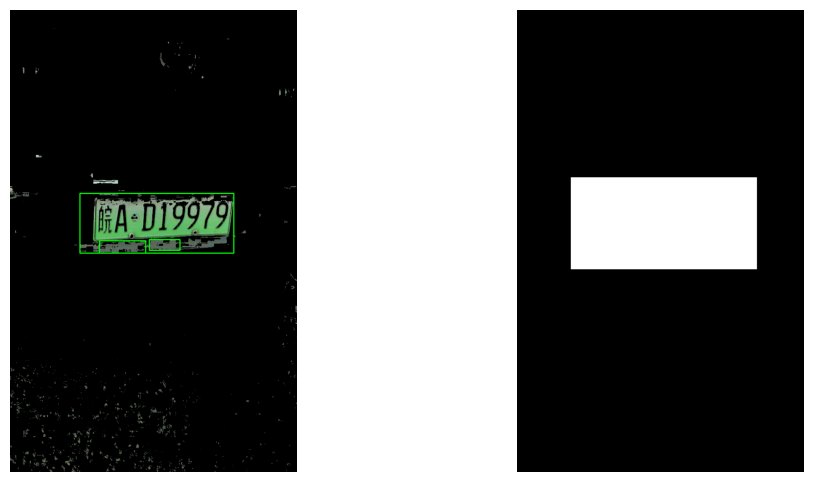

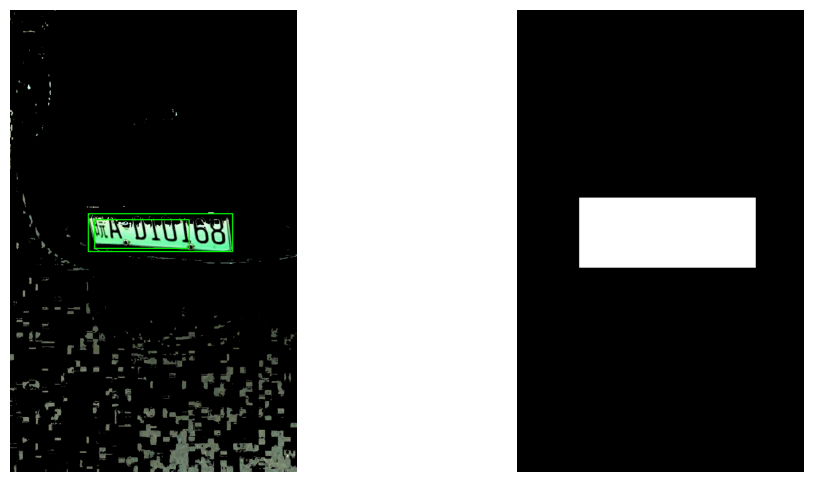

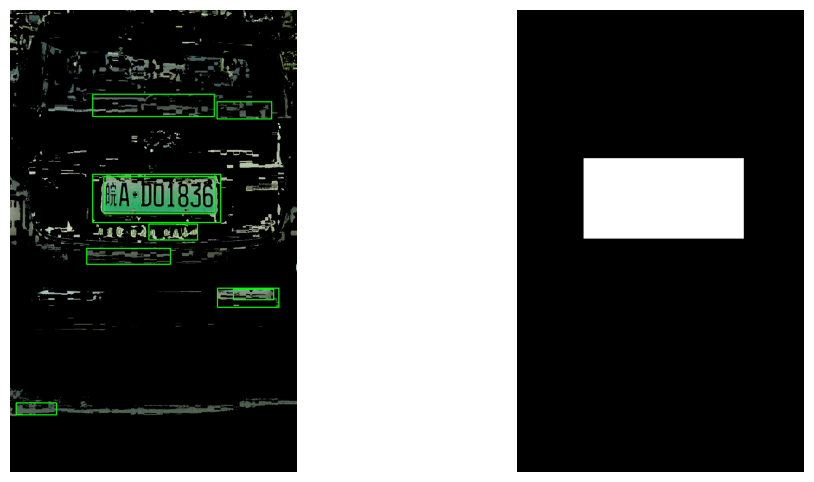

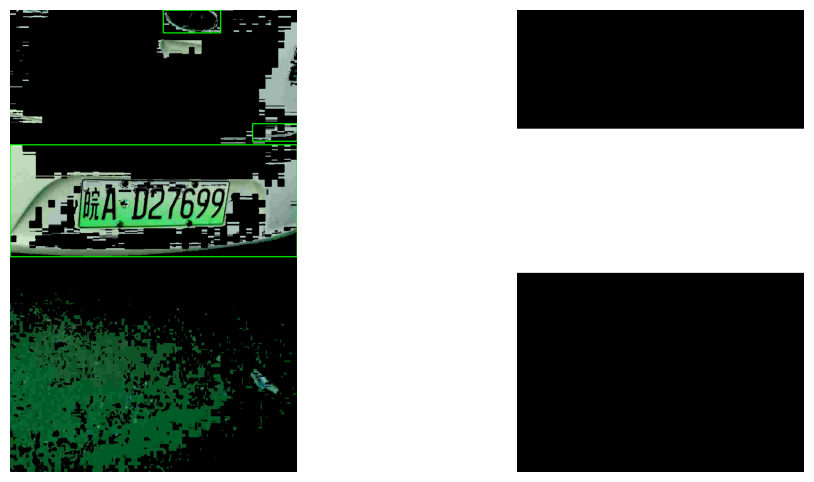

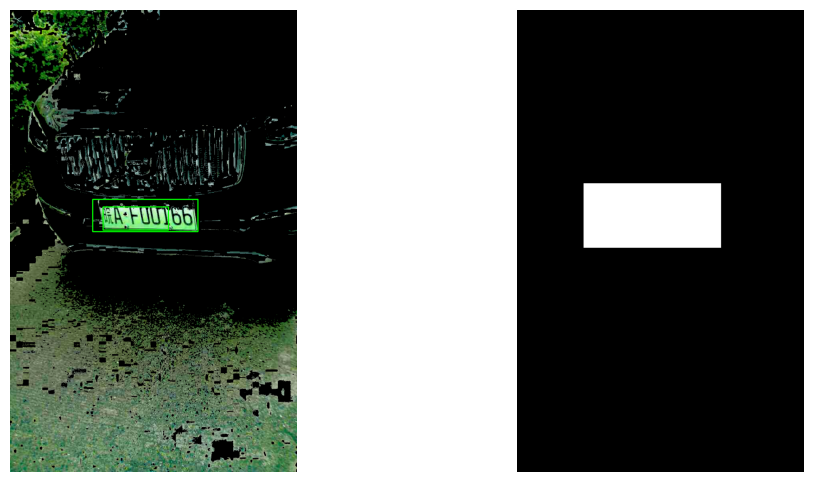

In [10]:
def process_images(image_list, show_results=False, max_show=25):
    """
    处理图像列表，生成对应的掩模并进行二次筛选。
    :param image_list: 输入的图像列表
    :param show_results: 是否显示中间结果
    :param max_show: 最大显示数量
    :return: 生成的掩模列表
    """
    masks = []
    for i, img in enumerate(image_list):
        try:
            # 转为灰度图像
            gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

            # 高斯滤波 + Canny边缘检测
            blurred = cv2.GaussianBlur(gray, (5, 5), 1.5)
            edges = cv2.Canny(blurred, threshold1=10, threshold2=150)

            # 闭运算
            kernel = np.ones((5, 5), np.uint8)
            closed = cv2.morphologyEx(edges, cv2.MORPH_CLOSE, kernel)

            # 查找轮廓
            contours, _ = cv2.findContours(closed, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

            # 创建初步掩模
            initial_mask = np.zeros_like(gray)
            for contour in contours:
                x, y, w, h = cv2.boundingRect(contour)
                aspect_ratio = w / float(h)
                area = cv2.contourArea(contour)

                # 打印调试信息：查看每个区域的宽高比和面积
                # print(f"Contour {i}: aspect_ratio={aspect_ratio:.2f}, area={area}")

                # 条件过滤：长宽比范围和面积阈值
                if 2.5 < aspect_ratio < 5.5 and area > 1000:  # 放宽条件
                    cv2.rectangle(img, (x, y), (x + w, y + h), (0, 255, 0), 2)
                    cv2.rectangle(initial_mask, (x, y), (x + w, y + h), 255, -1)

            # 二次筛选，通过面积和轮廓查找最优区域
            contours, _ = cv2.findContours(initial_mask, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
            final_mask = np.zeros_like(gray)
            best_contour = None
            max_area = -1

            for contour in contours:
                area = cv2.contourArea(contour)
                if area > max_area:
                    best_contour = contour
                    max_area = area

            if best_contour is not None:
                cv2.drawContours(final_mask, [best_contour], -1, 255, -1)


            # 膨胀操作扩展掩模区域
            final_mask = cv2.dilate(final_mask, np.ones((9, 9), np.uint8), iterations=10)  # 调整膨胀次数

            # 保存处理后的掩模
            masks.append(final_mask)

            # 显示中间结果
            if show_results and i < max_show:
                show(img, None, final_mask, "gray")

        except Exception as e:
            print(f"Error processing image {i + 1}: {e}")
            masks.append(None)

    return masks


# 处理训练、验证和测试集
train_masks = process_images(green_train_img, show_results=True)
val_masks = process_images(green_val_img)
test_masks = process_images(green_test_img)


### 2.1.4 分割车牌

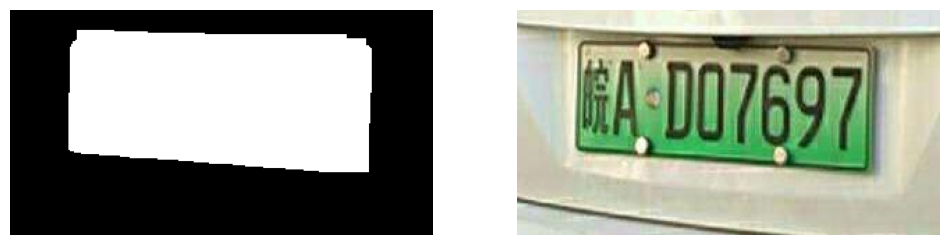

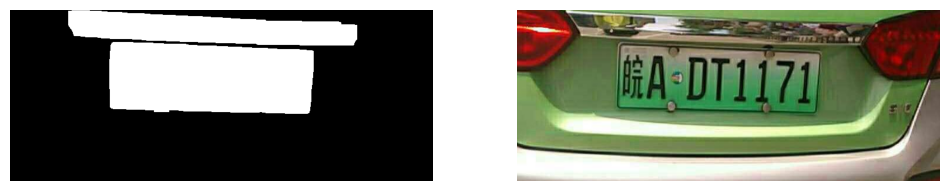

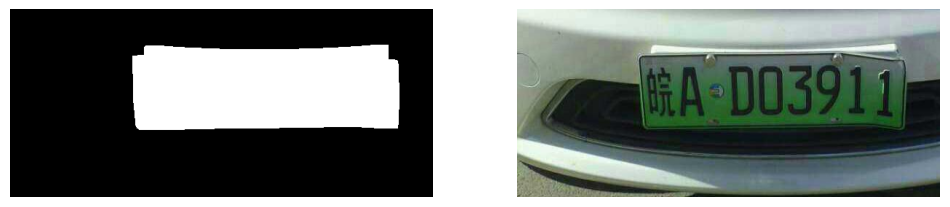

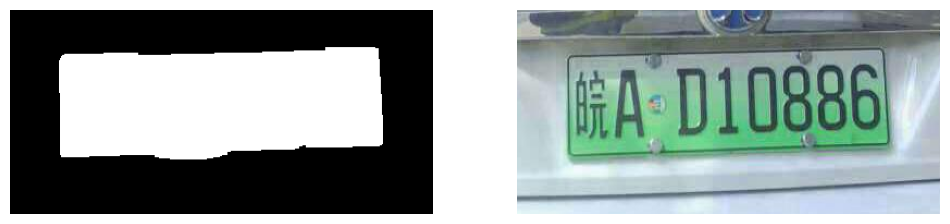

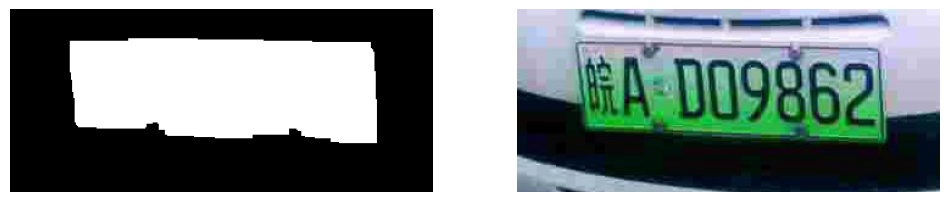

...

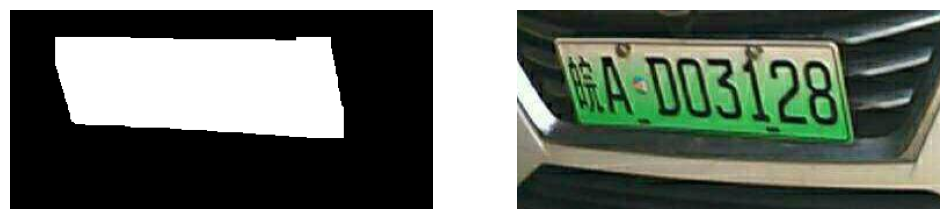

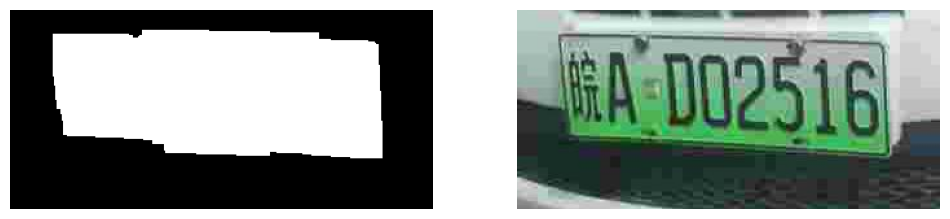

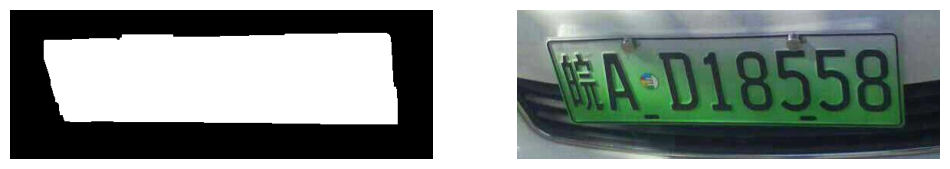

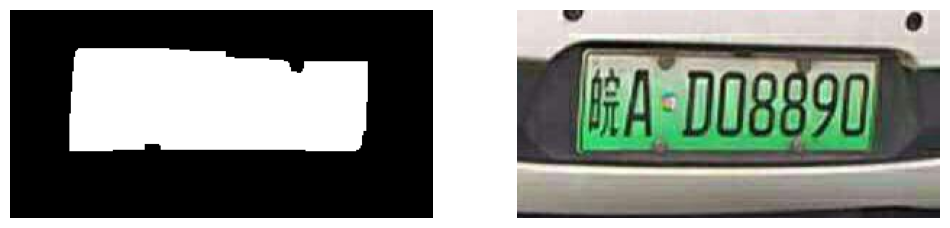

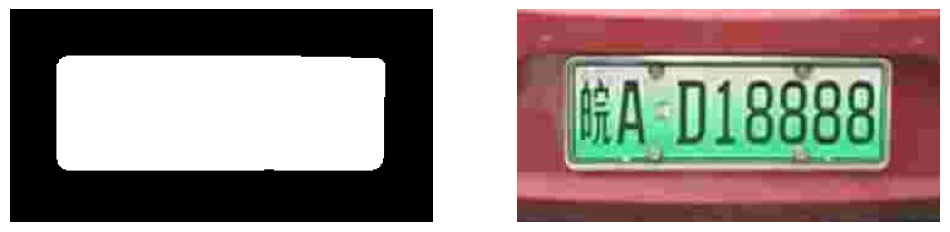

Error processing training image 73: OpenCV(4.10.0) /io/opencv/modules/imgproc/src/color.cpp:196: error: (-215:Assertion failed) !_src.empty() in function 'cvtColor'

Error processing training image 85: OpenCV(4.10.0) /io/opencv/modules/imgproc/src/color.cpp:196: error: (-215:Assertion failed) !_src.empty() in function 'cvtColor'

Error processing training image 86: No valid contour found
Error processing training image 267: OpenCV(4.10.0) /io/opencv/modules/imgproc/src/color.cpp:196: error: (-215:Assertion failed) !_src.empty() in function 'cvtColor'

Error processing training image 272: OpenCV(4.10.0) /io/opencv/modules/imgproc/src/color.cpp:196: error: (-215:Assertion failed) !_src.empty() in function 'cvtColor'

Error processing training image 277: OpenCV(4.10.0) /io/opencv/modules/imgproc/src/color.cpp:196: error: (-215:Assertion failed) !_src.empty() in function 'cvtColor'

Error processing training image 326: OpenCV(4.10.0) /io/opencv/modules/imgproc/src/color.cpp:196: error: (-2

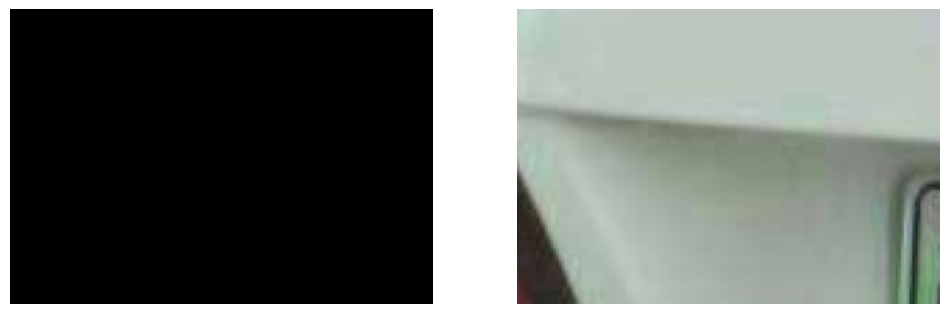

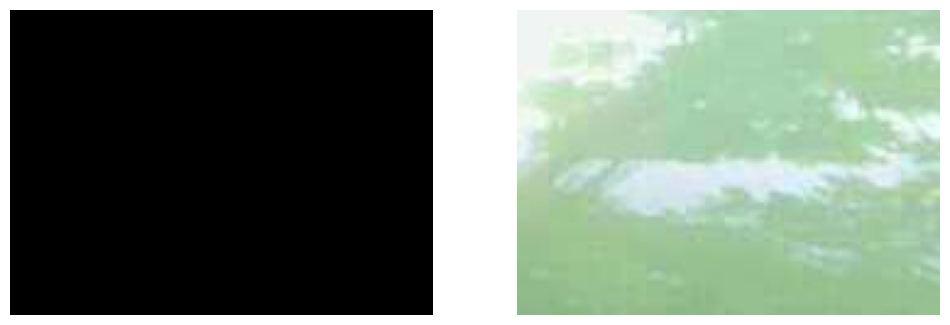

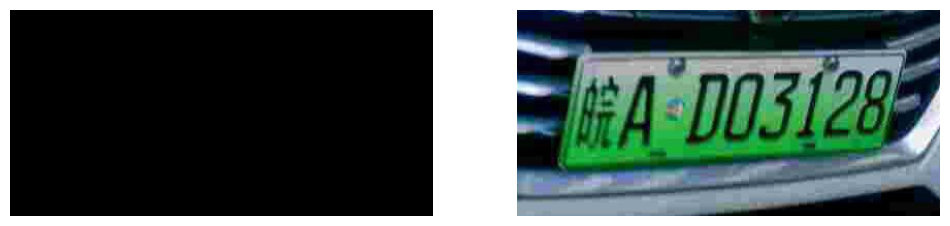

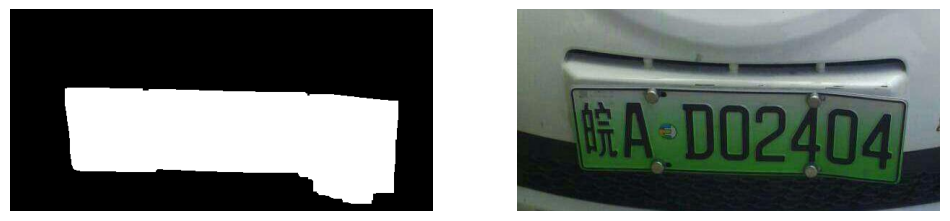

Error processing validation image 6: OpenCV(4.10.0) /io/opencv/modules/imgproc/src/color.cpp:196: error: (-215:Assertion failed) !_src.empty() in function 'cvtColor'



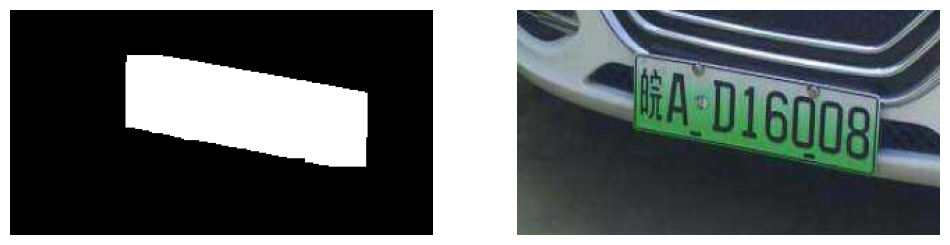

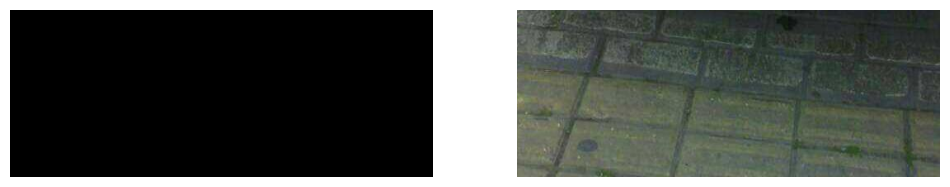

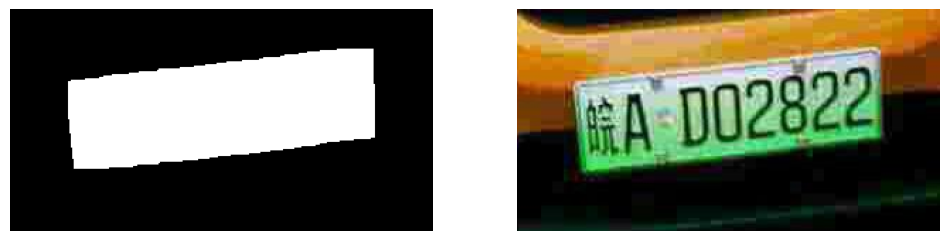

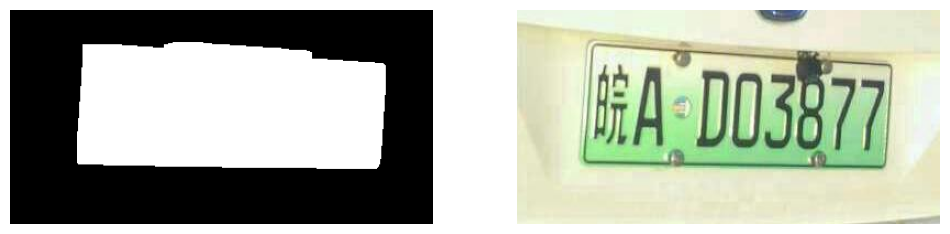

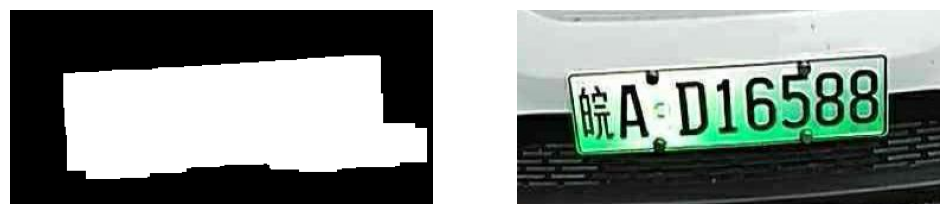

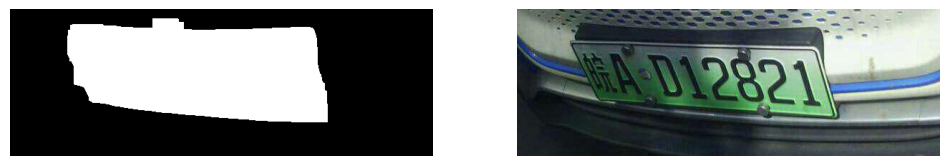

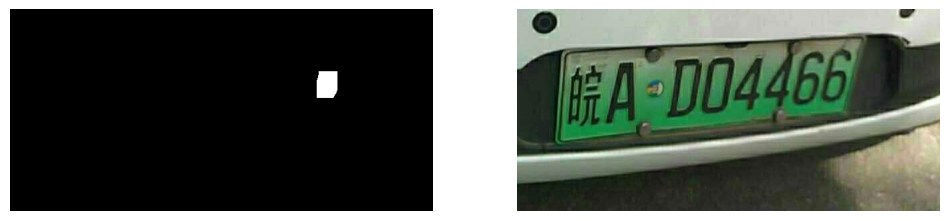

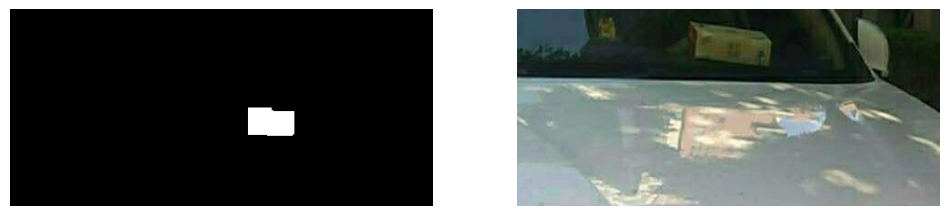

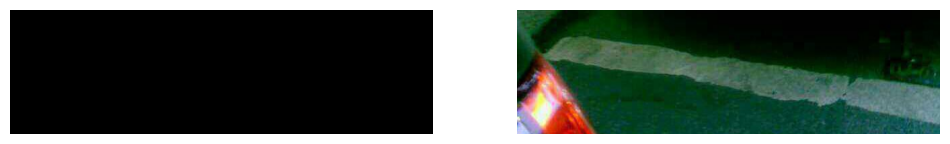

Error processing validation image 24: OpenCV(4.10.0) /io/opencv/modules/imgproc/src/color.cpp:196: error: (-215:Assertion failed) !_src.empty() in function 'cvtColor'

Error processing validation image 25: OpenCV(4.10.0) /io/opencv/modules/imgproc/src/color.cpp:196: error: (-215:Assertion failed) !_src.empty() in function 'cvtColor'

Error processing validation image 28: OpenCV(4.10.0) /io/opencv/modules/imgproc/src/color.cpp:196: error: (-215:Assertion failed) !_src.empty() in function 'cvtColor'

Error processing validation image 35: OpenCV(4.10.0) /io/opencv/modules/imgproc/src/color.cpp:196: error: (-215:Assertion failed) !_src.empty() in function 'cvtColor'

Error processing validation image 44: OpenCV(4.10.0) /io/opencv/modules/imgproc/src/color.cpp:196: error: (-215:Assertion failed) !_src.empty() in function 'cvtColor'

Error processing validation image 63: OpenCV(4.10.0) /io/opencv/modules/imgproc/src/color.cpp:196: error: (-215:Assertion failed) !_src.empty() in function 'cvt

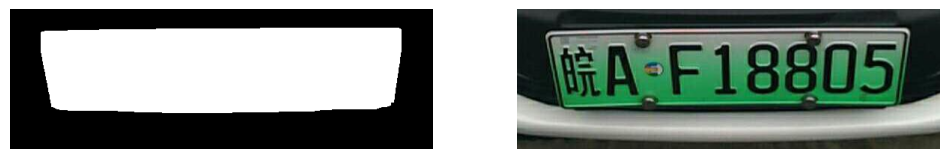

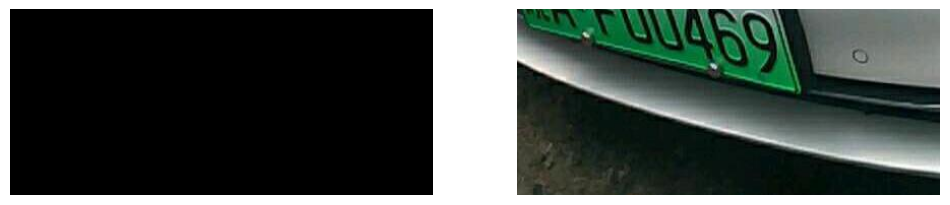

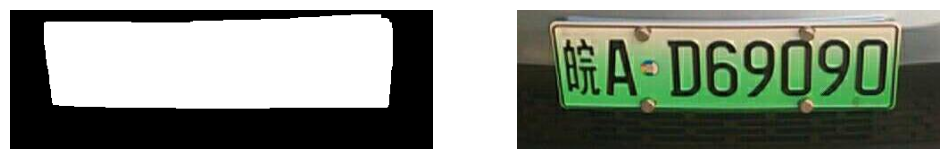

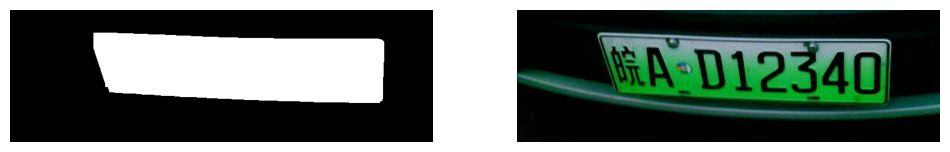

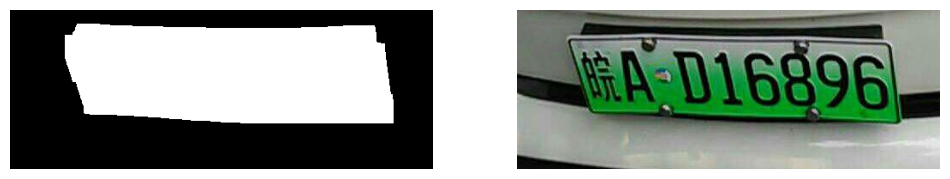

...

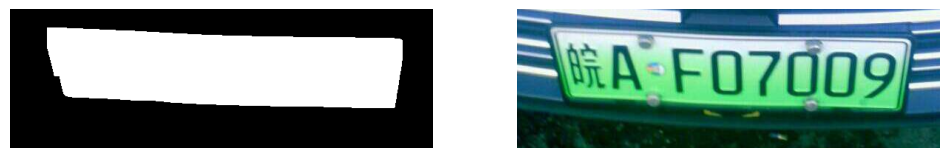

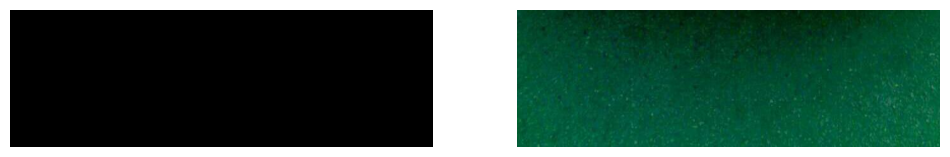

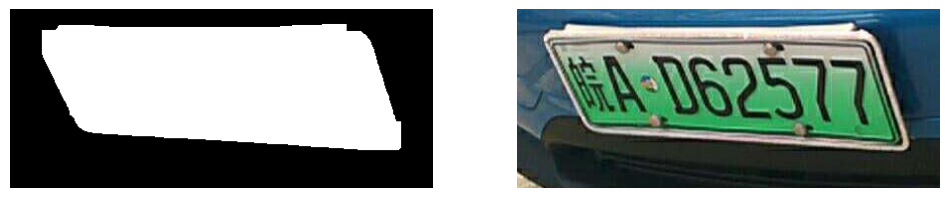

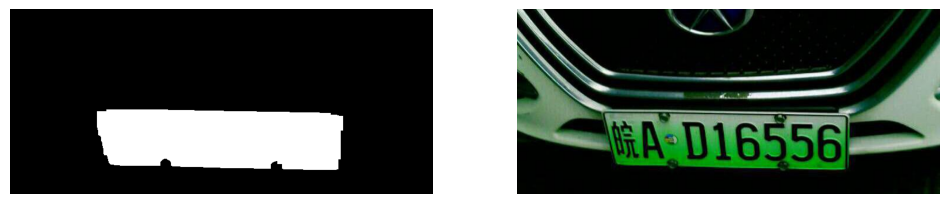

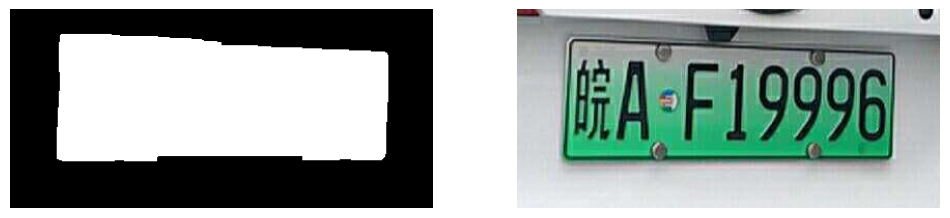

Error processing test image 40: OpenCV(4.10.0) /io/opencv/modules/imgproc/src/color.cpp:196: error: (-215:Assertion failed) !_src.empty() in function 'cvtColor'

Error processing test image 68: OpenCV(4.10.0) /io/opencv/modules/imgproc/src/color.cpp:196: error: (-215:Assertion failed) !_src.empty() in function 'cvtColor'

Error processing test image 74: OpenCV(4.10.0) /io/opencv/modules/imgproc/src/color.cpp:196: error: (-215:Assertion failed) !_src.empty() in function 'cvtColor'

Error processing test image 93: OpenCV(4.10.0) /io/opencv/modules/imgproc/src/color.cpp:196: error: (-215:Assertion failed) !_src.empty() in function 'cvtColor'

Error processing test image 101: No valid contour found
Error processing test image 116: OpenCV(4.10.0) /io/opencv/modules/imgproc/src/color.cpp:196: error: (-215:Assertion failed) !_src.empty() in function 'cvtColor'

Error processing test image 133: OpenCV(4.10.0) /io/opencv/modules/imgproc/src/color.cpp:196: error: (-215:Assertion failed) !_src.em

In [11]:
def process_dataset(img_list, mask_list, set_name, max_show=15):
    """
    处理数据集，生成新掩模和裁剪位置，并统计丢失的图片。
    :param img_list: 图像列表
    :param mask_list: 掩模列表
    :param set_name: 数据集名称（用于打印日志）
    :param max_show: 显示前多少张处理的图像
    :return: 新掩模列表、裁剪位置列表、丢失图片下标列表、丢失计数
    """
    new_masks = []
    crop_positions = []
    lost_indices = []
    lost_count = 0

    for i, (img, mask) in enumerate(zip(img_list, mask_list)):
      try:
        # 找到掩模非零区域
        points = np.argwhere(mask)
        x, y, w, h = cv2.boundingRect(points)
        crop_positions.append((y, x))

        # 裁剪出感兴趣区域
        mask_img = img[x:x + w, y:y + h].copy()

        # 转灰度图和高斯滤波
        gray = cv2.cvtColor(mask_img, cv2.COLOR_BGR2GRAY)
        blurred = cv2.GaussianBlur(gray, (3, 3), 1.5)

        # Canny边缘检测
        edges = cv2.Canny(blurred, threshold1=10, threshold2=150)

        # 闭运算
        kernel = np.ones((3, 3), np.uint8)
        new_mask_1 = cv2.morphologyEx(edges, cv2.MORPH_CLOSE, kernel)

        # 找到最大轮廓
        contours, _ = cv2.findContours(new_mask_1, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        best_contour = max(contours, key=cv2.contourArea, default=None)

        if best_contour is None:
            raise ValueError("No valid contour found")

        # 在掩模上绘制轮廓
        cv2.drawContours(new_mask_1, [best_contour], -1, (255, 0, 0), -1)

        # 二次筛选（去除无效区域）
        kernel = np.ones((25, 25), np.uint8)
        new_mask_2 = cv2.morphologyEx(new_mask_1, cv2.MORPH_OPEN, kernel)

        new_masks.append(new_mask_2)

        # 显示前几张图像结果
        if i < max_show:
          show(new_mask_2, 'gray', mask_img, None)

      except Exception as e:
        lost_indices.append(i)
        lost_count += 1
        print(f"Error processing {set_name} image {i + 1}: {e}")
        continue

    return new_masks, crop_positions, lost_indices, lost_count

# 处理训练集、验证集和测试集
train_new_masks, train_crop_positions, train_lost_indices, train_lost = process_dataset(
    train_img, train_masks, "training", max_show=15
)
val_new_masks, val_crop_positions, val_lost_indices, val_lost = process_dataset(
    val_img, val_masks, "validation"
)
test_new_masks, test_crop_positions, test_lost_indices, test_lost = process_dataset(
    test_img, test_masks, "test"
)

# 输出统计信息
print(f"Train set: {train_lost}/{len(train_img)} images lost")
print(f"Validation set: {val_lost}/{len(val_img)} images lost")
print(f"Test set: {test_lost}/{len(test_img)} images lost")

# 输出丢失图片的下标
print(f"Lost image indices in the train set: {train_lost_indices}")
print(f"Lost image indices in the validation set: {val_lost_indices}")
print(f"Lost image indices in the test set: {test_lost_indices}")

## **2.2 评价指标**

结果很差，交并比只有百分之二十二，推测是将掩模“贴”回原图时位置有偏差。

同时由于结果过差，不足以训练模型，于是暂时只做了正确数据集的训练以验证模型的正确性。

In [15]:
def calculate_iou(mask1, mask2):
  intersection = np.logical_and(mask1, mask2).astype(np.uint8)
  union = np.logical_or(mask1, mask2).astype(np.uint8)
  iou = np.sum(intersection) / np.sum(union)
  return iou

In [16]:
temp_img = []
for i, img in enumerate(train_img):
  if i in train_lost_indices:  # 如果是丢失的训练集图片，跳过
    continue
  temp_img.append(img)
train_img = temp_img

temp_img = []
for i, img in enumerate(val_img):
  if i in val_lost_indices:
    continue
  temp_img.append(img)
val_img = temp_img

temp_img = []
for i, img in enumerate(test_img):
  if i in test_lost_indices:
    continue
  temp_img.append(img)
test_img = temp_img

True box: [440, 544], [221, 534], [226, 451], [437, 461]
Predicted corners: [(226, 445), (444, 445), (444, 547), (226, 547)]


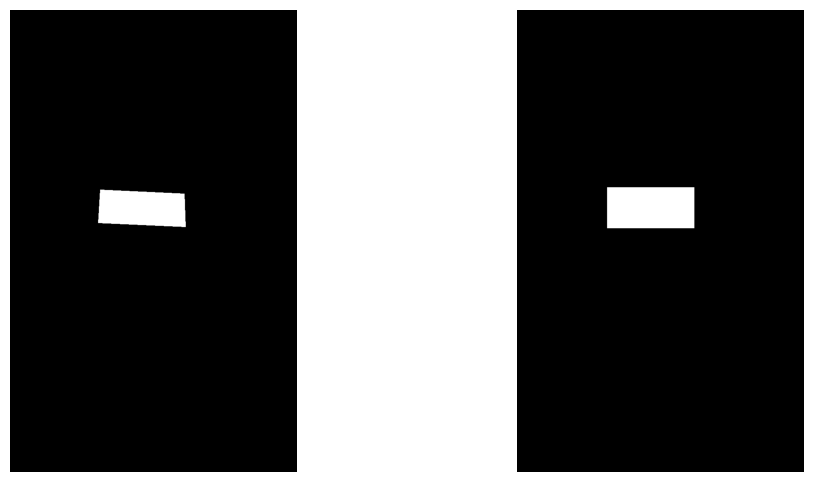

True box: [507, 522], [176, 506], [175, 399], [519, 414]
Predicted corners: [(99, 342), (591, 342), (591, 518), (99, 518)]


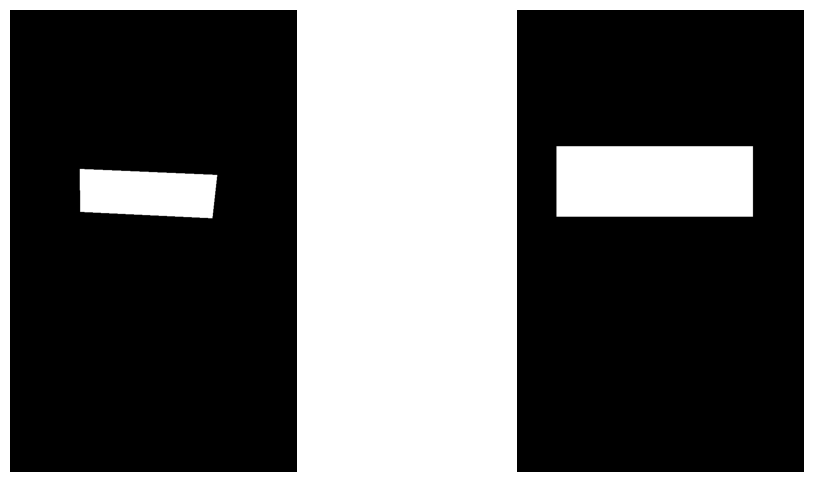

True box: [533, 564], [175, 569], [166, 468], [534, 471]
Predicted corners: [(168, 452), (535, 452), (535, 569), (168, 569)]


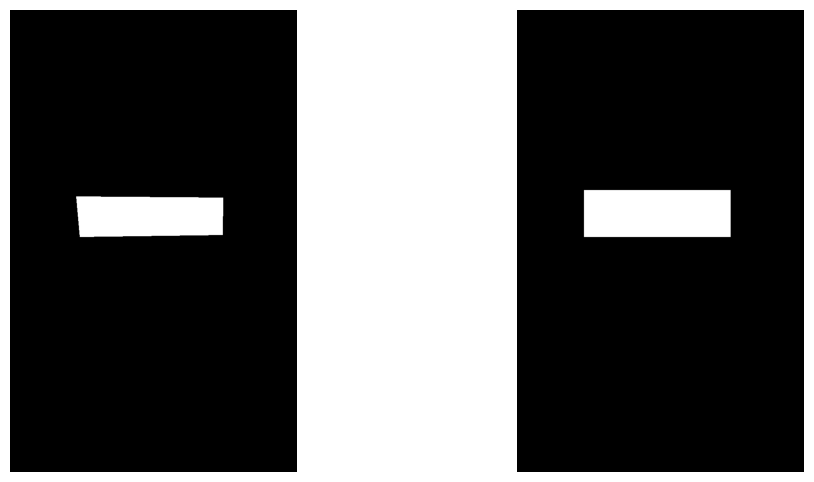

True box: [499, 567], [201, 574], [204, 489], [492, 481]
Predicted corners: [(201, 481), (499, 481), (499, 584), (201, 584)]


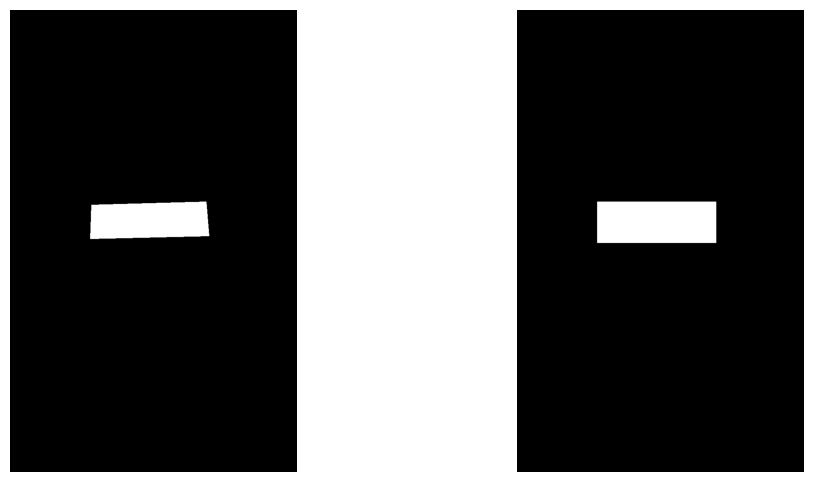

True box: [468, 534], [222, 522], [215, 456], [462, 457]
Predicted corners: [(217, 452), (469, 452), (469, 538), (217, 538)]


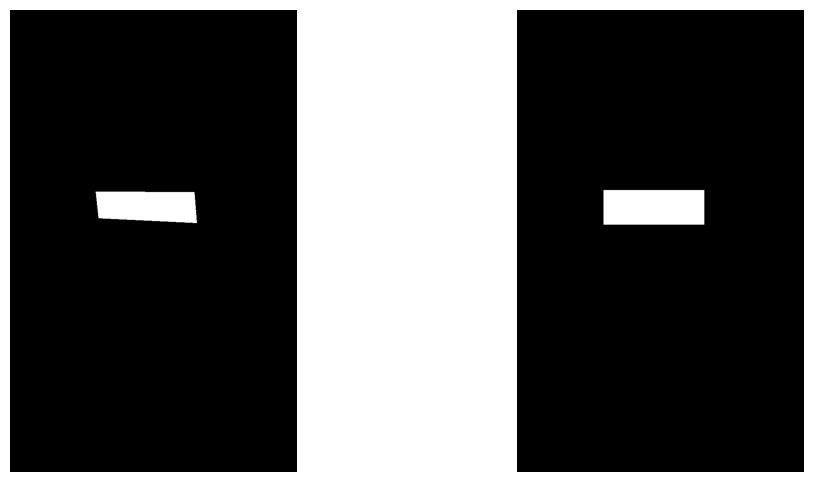

True box: [538, 629], [122, 618], [122, 499], [539, 497]
Predicted corners: [(119, 492), (543, 492), (543, 655), (119, 655)]


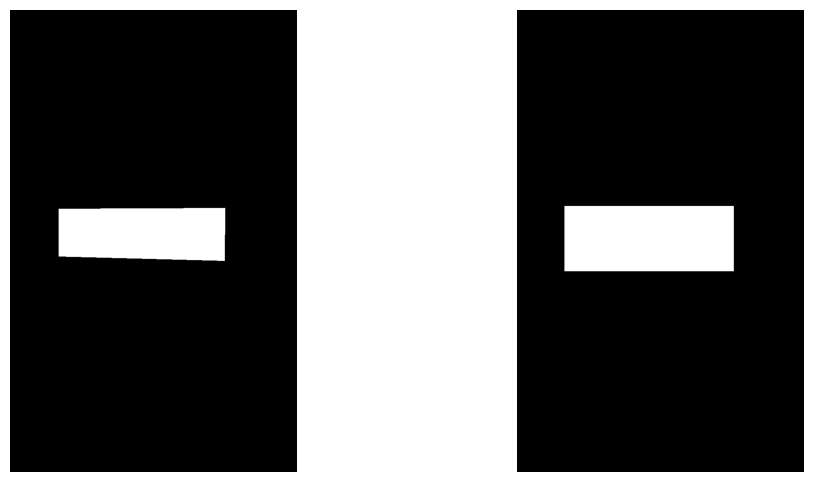

True box: [489, 524], [232, 538], [229, 456], [492, 447]
Predicted corners: [(226, 446), (495, 446), (495, 549), (226, 549)]


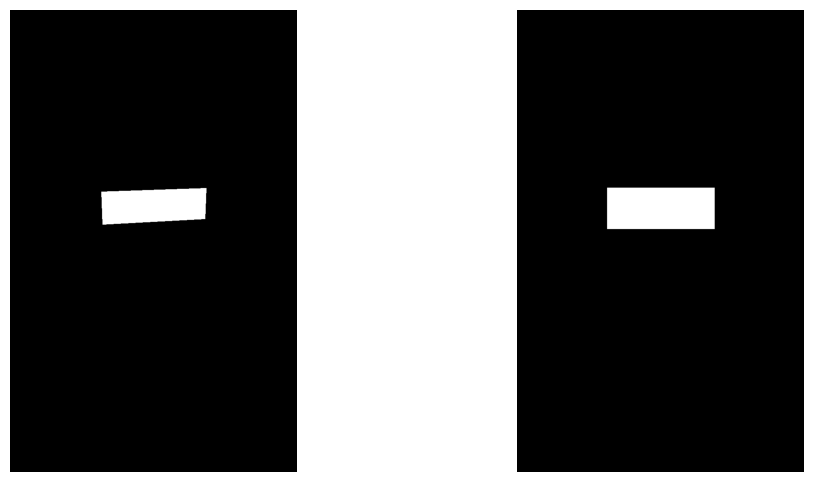

True box: [509, 574], [264, 570], [253, 491], [523, 495]
Predicted corners: [(250, 483), (519, 483), (519, 572), (250, 572)]


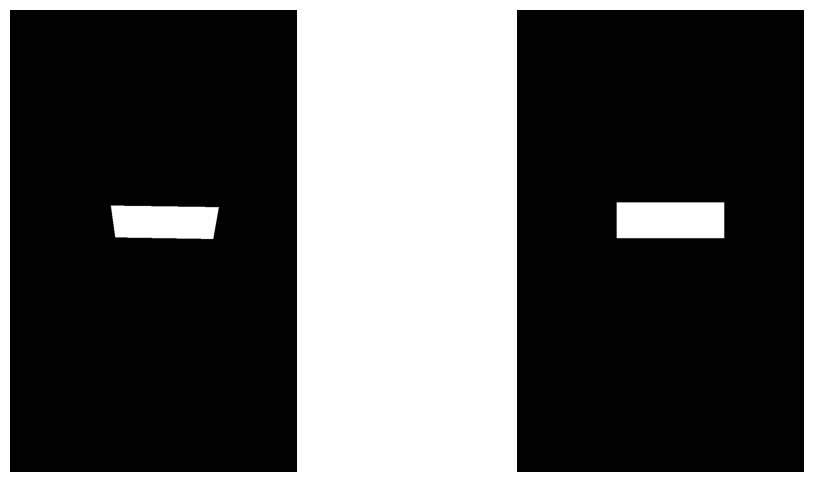

True box: [479, 610], [227, 613], [215, 538], [474, 541]
Predicted corners: [(170, 505), (170, 505), (170, 505), (170, 505)]


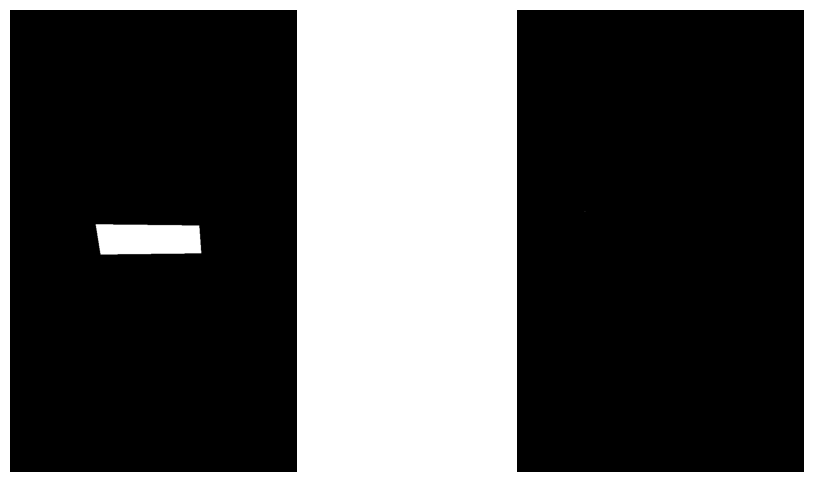

True box: [543, 536], [84, 544], [78, 409], [547, 403]
Predicted corners: [(77, 402), (552, 402), (552, 550), (77, 550)]


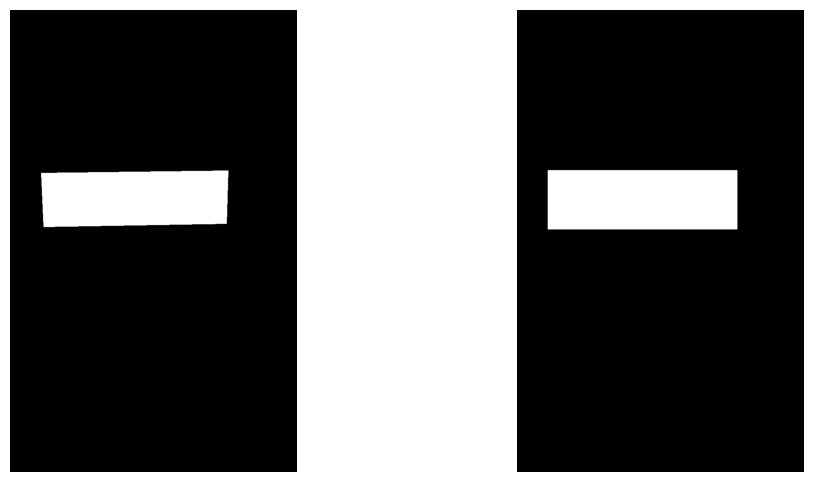

Train Dataset: 2384/2391 images with IOU < 0.9
Train Average IOU: 0.18
True box: [458, 558], [138, 575], [144, 432], [470, 431]
Predicted corners: [(0, 0), (0, 0), (0, 0), (0, 0)]


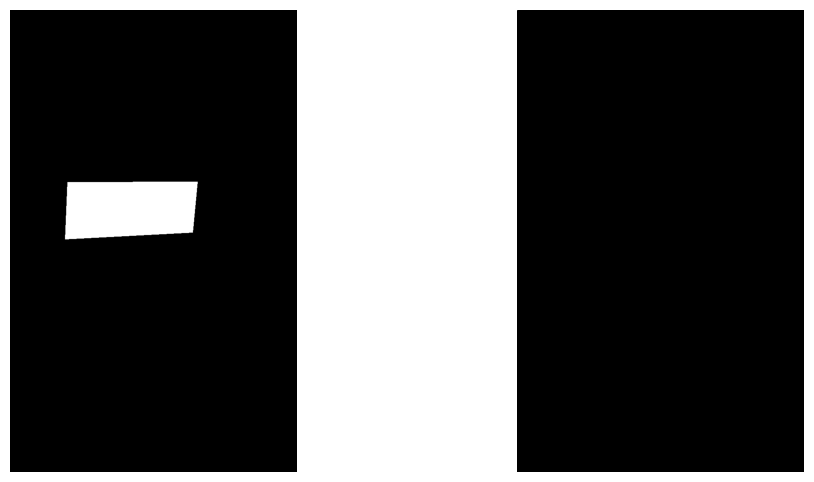

True box: [467, 590], [229, 493], [221, 415], [465, 508]
Predicted corners: [(1, 376), (1, 376), (1, 376), (1, 376)]


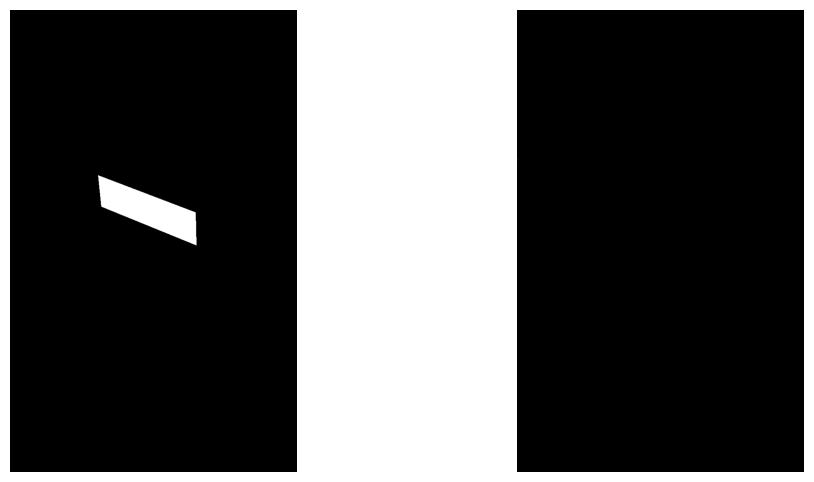

True box: [450, 548], [137, 565], [156, 459], [471, 456]
Predicted corners: [(547, 137), (547, 137), (547, 137), (547, 137)]


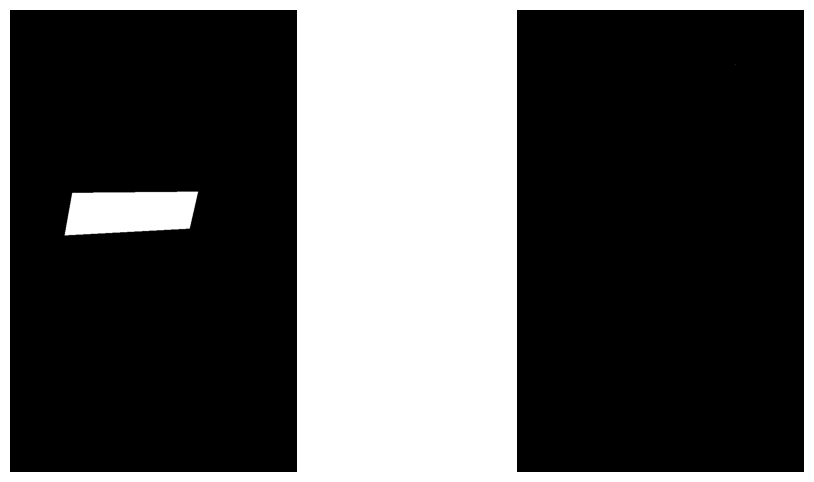

True box: [529, 537], [91, 520], [73, 408], [536, 425]
Predicted corners: [(171, 522), (633, 522), (633, 683), (171, 683)]


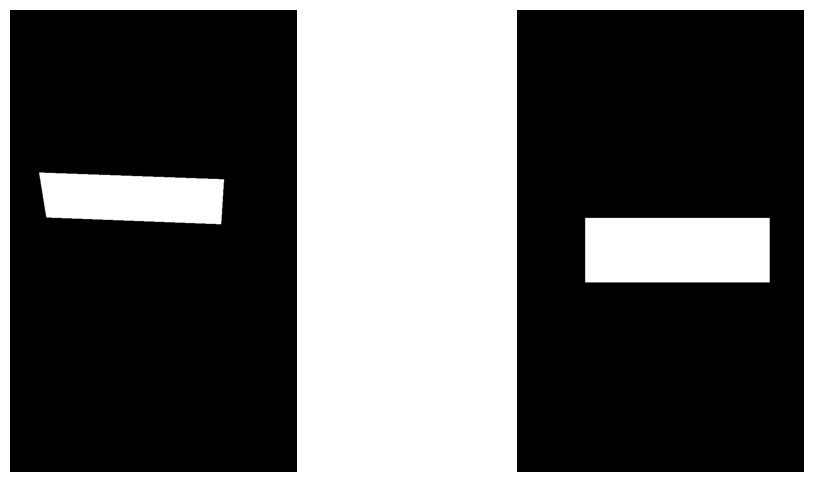

True box: [477, 509], [305, 474], [307, 423], [485, 453]
Predicted corners: [(83, 332), (257, 332), (257, 412), (83, 412)]


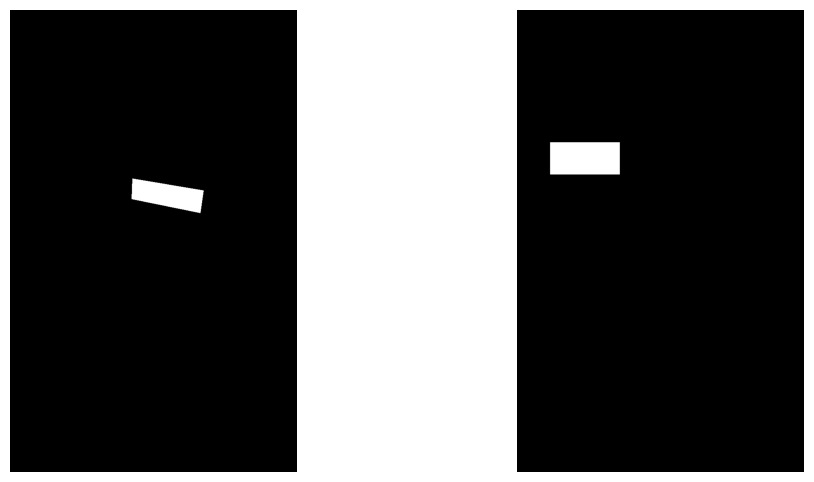

True box: [483, 580], [175, 549], [177, 459], [488, 485]
Predicted corners: [(0, 0), (0, 0), (0, 0), (0, 0)]


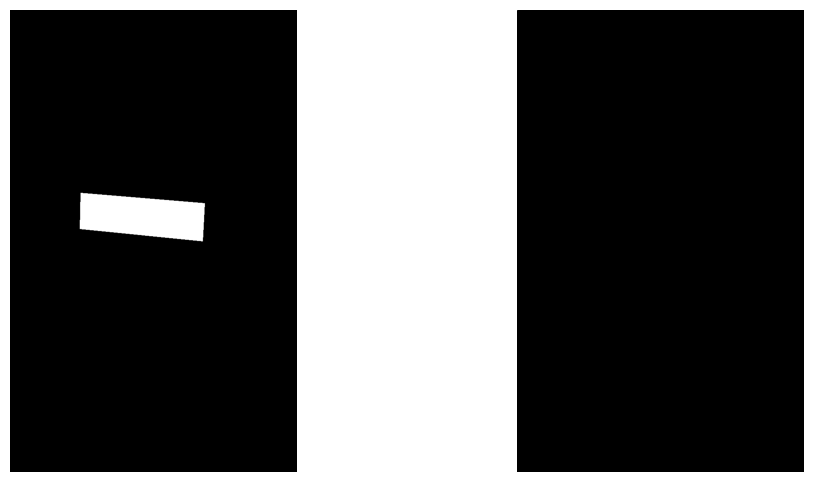

True box: [536, 599], [256, 589], [265, 488], [543, 509]
Predicted corners: [(100, 987), (381, 987), (381, 1102), (100, 1102)]


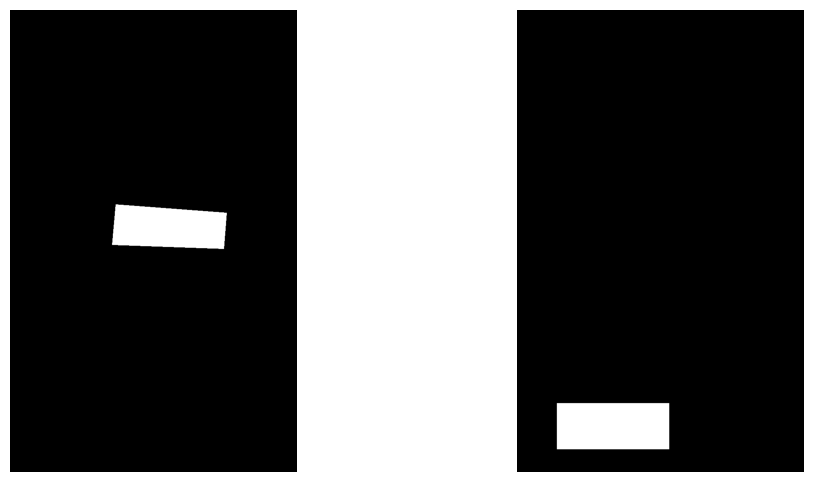

True box: [481, 565], [229, 583], [214, 512], [481, 504]
Predicted corners: [(284, 412), (591, 412), (591, 516), (284, 516)]


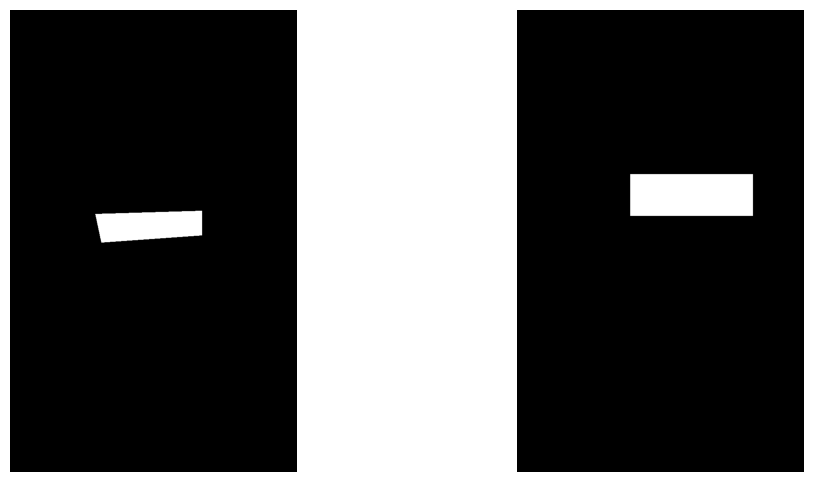

True box: [572, 566], [241, 544], [202, 467], [545, 474]
Predicted corners: [(279, 473), (643, 473), (643, 618), (279, 618)]


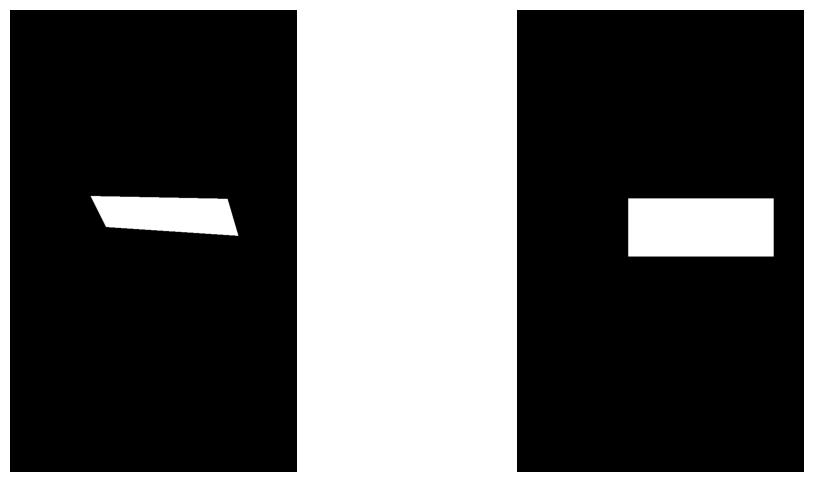

True box: [483, 553], [64, 571], [60, 445], [514, 421]
Predicted corners: [(627, 555), (658, 555), (658, 595), (627, 595)]


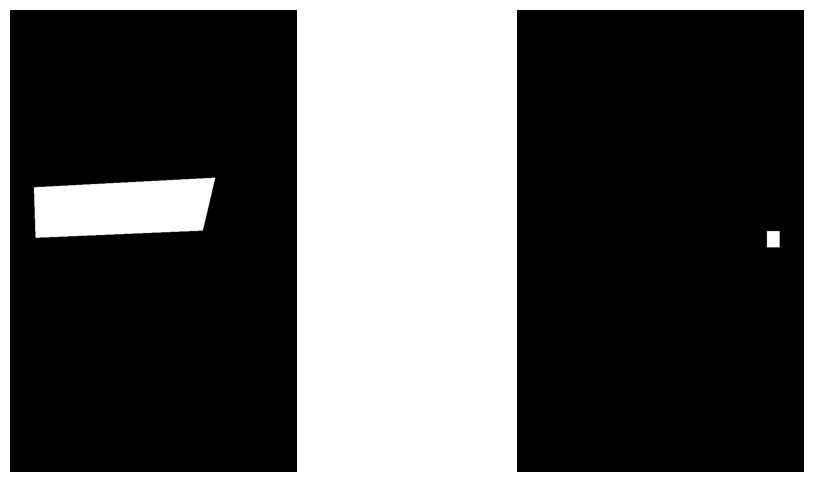

Validation Dataset: 400/432 images with IOU < 0.5
Validation Average IOU: 0.13
True box: [580, 585], [311, 520], [285, 447], [557, 500]
Predicted corners: [(304, 507), (304, 507), (304, 507), (304, 507)]


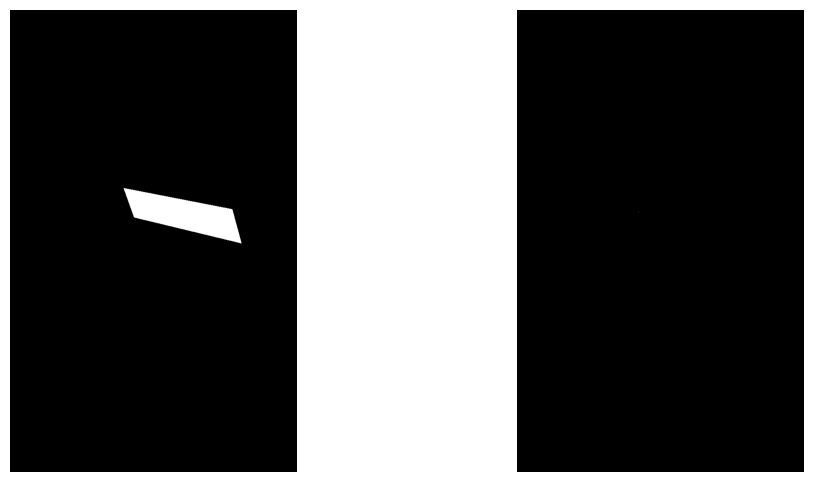

True box: [561, 606], [222, 618], [218, 525], [566, 516]
Predicted corners: [(0, 868), (0, 868), (0, 868), (0, 868)]


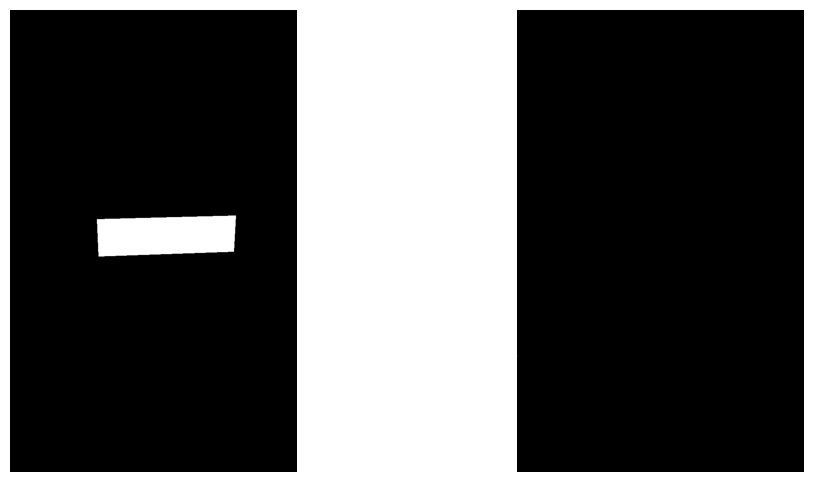

True box: [482, 530], [165, 531], [187, 435], [513, 446]
Predicted corners: [(120, 422), (120, 422), (120, 422), (120, 422)]


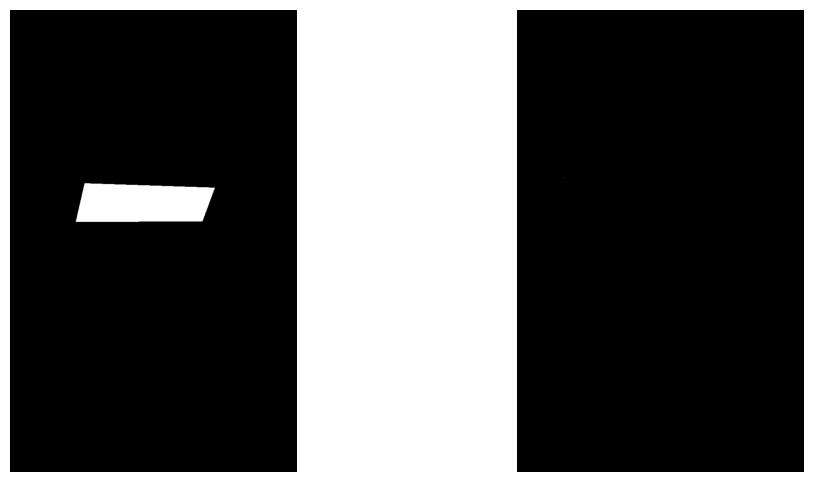

True box: [530, 653], [210, 640], [172, 560], [501, 562]
Predicted corners: [(650, 1116), (685, 1116), (685, 1150), (650, 1150)]


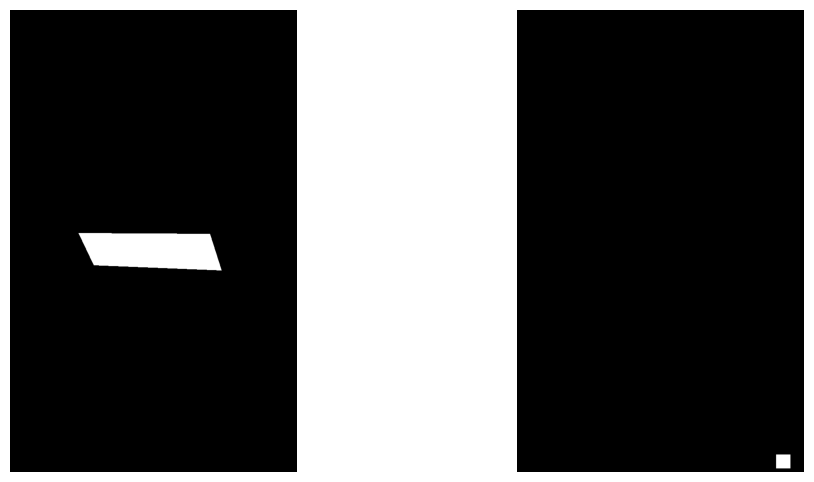

True box: [549, 655], [227, 647], [213, 549], [541, 557]
Predicted corners: [(266, 148), (460, 148), (460, 187), (266, 187)]


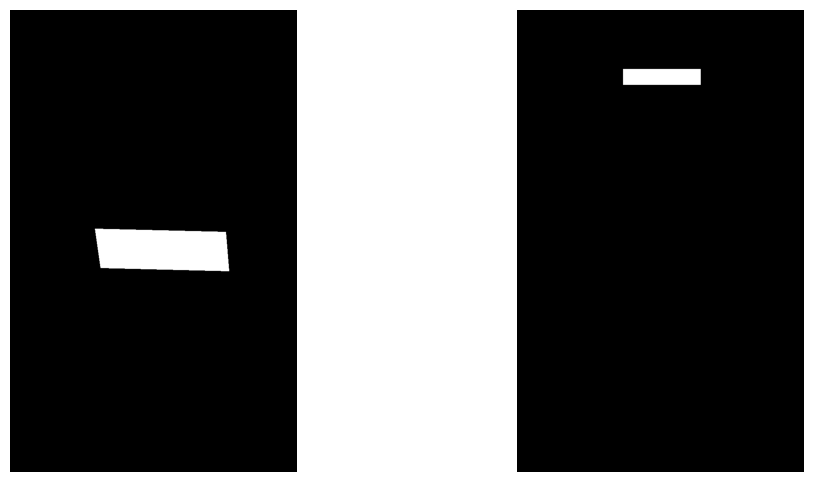

True box: [508, 618], [204, 585], [171, 507], [474, 526]
Predicted corners: [(158, 485), (158, 485), (158, 485), (158, 485)]


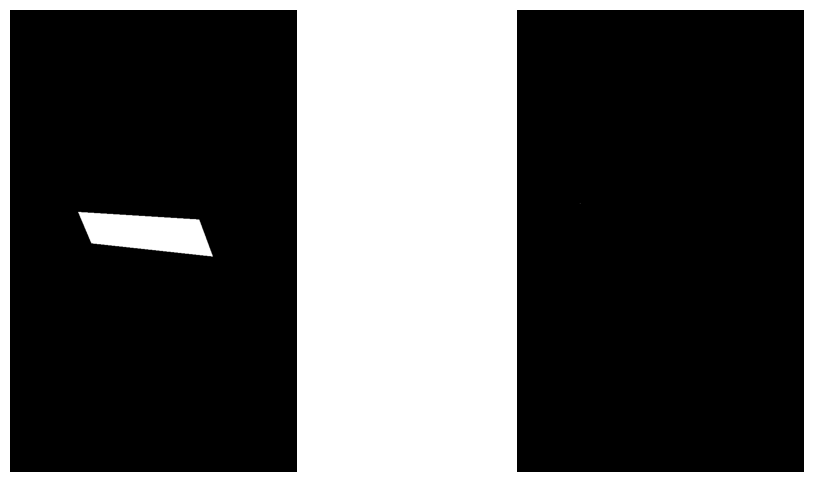

True box: [617, 586], [158, 573], [111, 483], [603, 483]
Predicted corners: [(440, 496), (485, 496), (485, 566), (440, 566)]


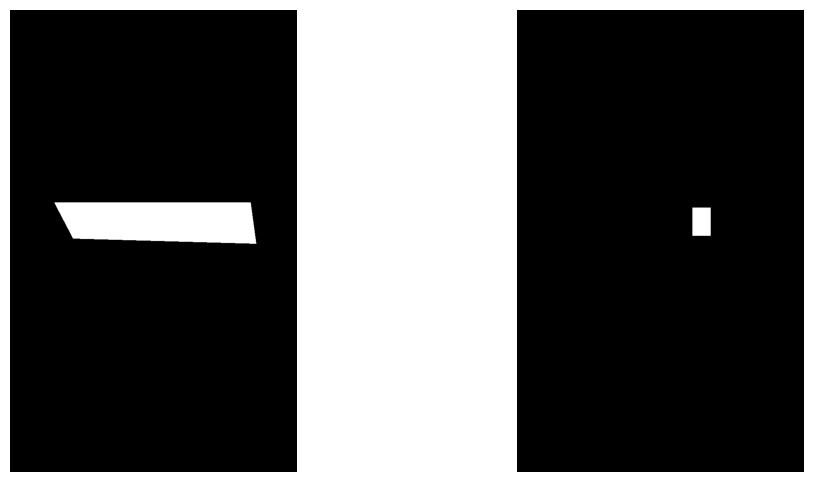

True box: [522, 631], [155, 601], [125, 527], [513, 554]
Predicted corners: [(130, 123), (526, 123), (526, 237), (130, 237)]


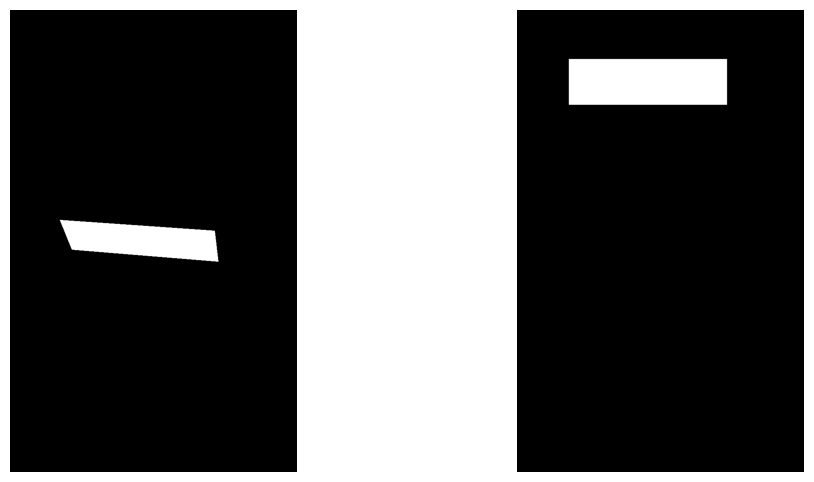

True box: [553, 561], [221, 617], [209, 495], [547, 449]
Predicted corners: [(0, 398), (0, 398), (0, 398), (0, 398)]


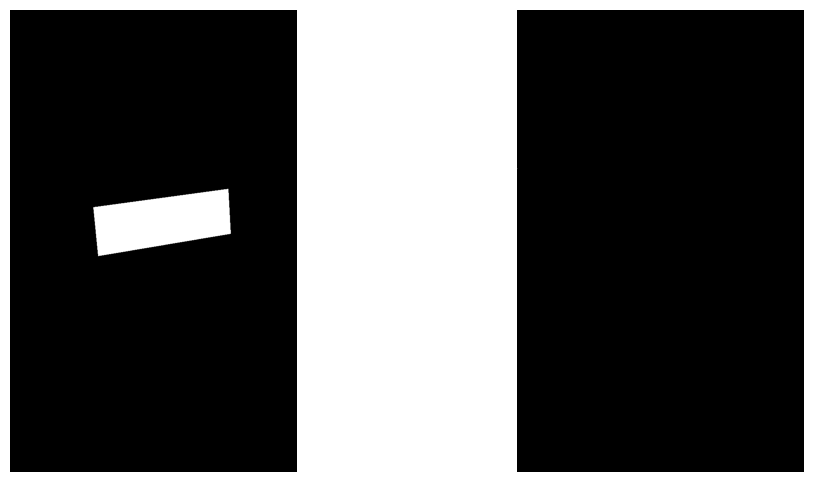

True box: [582, 621], [217, 611], [187, 525], [562, 522]
Predicted corners: [(38, 876), (431, 876), (431, 992), (38, 992)]


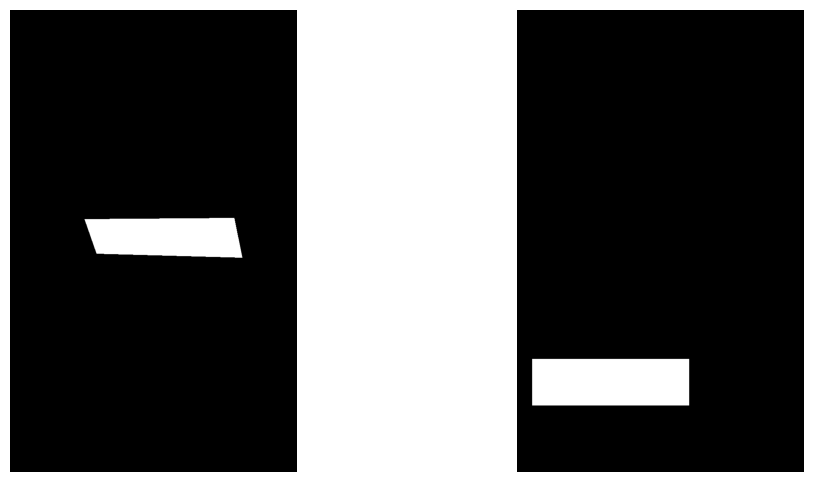

Test Dataset: 1976/2416 images with IOU < 0.5
Test Average IOU: 0.22


In [17]:
def evaluate_dataset(img_list, true_boxes_list, predicted_masks, crop_positions, set_name, iou_threshold=0.5, max_show=10):
  """
  评估数据集的预测掩模与真实掩模的 IOU 并输出统计信息。
  :param img_list: 图像列表
  :param true_boxes_list: 真实的 box 列表
  :param predicted_masks: 预测的掩模列表
  :param crop_positions: 裁剪位置列表
  :param set_name: 数据集名称
  :param iou_threshold: 判断 IOU 的阈值
  :param max_show: 显示低于阈值样本的最大数量
  :return: 平均 IOU，角点列表
  """
  corners_list = []
  evaluation_results = []
  low_iou_count = 0

  for i, (img, true_boxes, predicted_mask, (original_x, original_y)) in enumerate(
      zip(img_list, true_boxes_list, predicted_masks, crop_positions)
  ):
    try:
      # 获取 predicted_mask 的边界矩形框的角点
      mask_points = np.argwhere(predicted_mask)
      y, x, h, w = cv2.boundingRect(mask_points)

      # 将裁剪图像中的角点坐标转换到原图中的坐标
      mapped_corners = [
          (original_x + x, original_y + y),
          (original_x + x + w, original_y + y),
          (original_x + x + w, original_y + y + h),
          (original_x + x, original_y + y + h),
      ]
      corners_list.append(mapped_corners)

      # 生成预测掩模在原图上的位置
      pred_mask_mapped = np.zeros(img.shape[:2], dtype=np.uint8)
      cv2.fillPoly(pred_mask_mapped, [np.array(mapped_corners, dtype=np.int32)], 255)

      # 将真实的 boxes 转换为掩模格式
      true_mask = np.zeros(img.shape[:2], dtype=np.uint8)
      cv2.fillPoly(true_mask, [np.array(true_boxes, dtype=np.int32)], 255)

      # 计算 IOU
      iou = calculate_iou(true_mask, pred_mask_mapped)
      evaluation_results.append(iou)

      # 如果 IOU 低于阈值，记录并可视化
      if iou < iou_threshold:
        low_iou_count += 1
        if low_iou_count <= max_show:
          print(f"True box: {true_boxes[2]}, {true_boxes[3]}, {true_boxes[0]}, {true_boxes[1]}")
          print(f"Predicted corners: {mapped_corners}")
          show(true_mask, 'gray', pred_mask_mapped, 'gray')

    except Exception as e:
      print(f"Error processing {set_name} image {i + 1}: {e}")
      continue

  # 输出结果
  average_iou = sum(evaluation_results) / len(evaluation_results)
  print(f"{set_name} Dataset: {low_iou_count}/{len(img_list)} images with IOU < {iou_threshold}")
  print(f"{set_name} Average IOU: {average_iou:.2f}")

  return average_iou, corners_list


# 评估训练集
train_avg_iou, train_corners = evaluate_dataset(
    train_img, true_train_boxes, train_new_masks, train_crop_positions, "Train", iou_threshold=0.9
)

# 评估验证集
val_avg_iou, val_corners = evaluate_dataset(
    val_img, true_val_boxes, val_new_masks, val_crop_positions, "Validation"
)

# 评估测试集
test_avg_iou, test_corners = evaluate_dataset(
    test_img, true_test_boxes, test_new_masks, test_crop_positions, "Test"
)

## **2.3 透视变换**

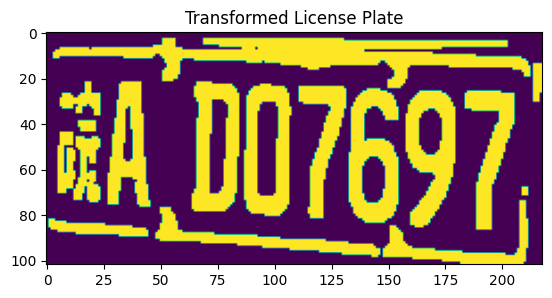

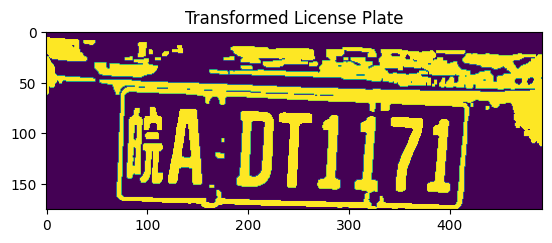

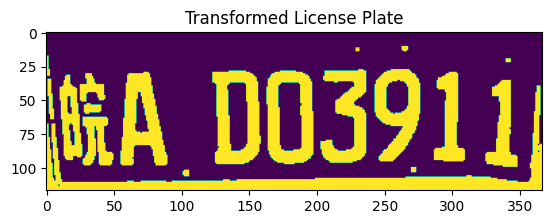

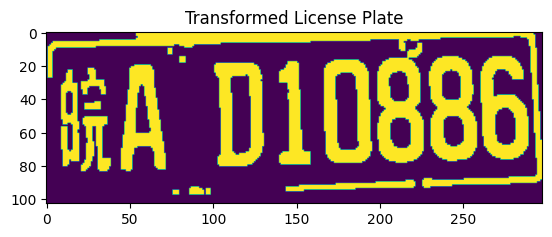

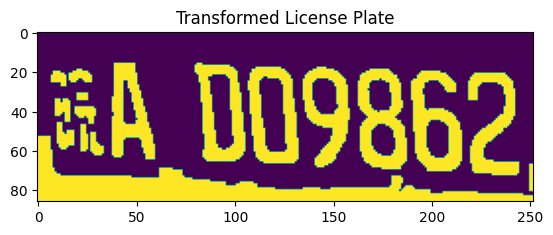

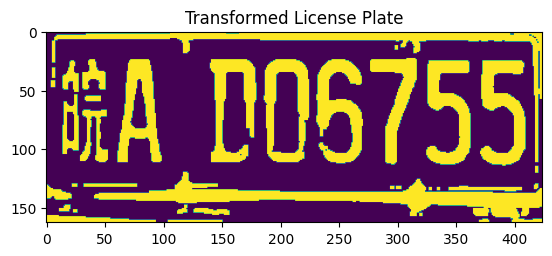

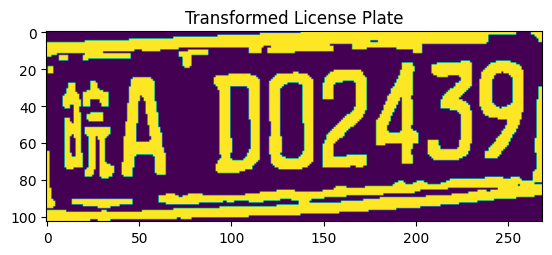

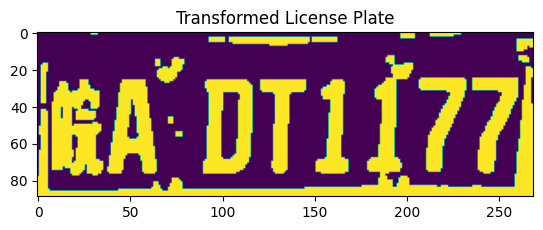

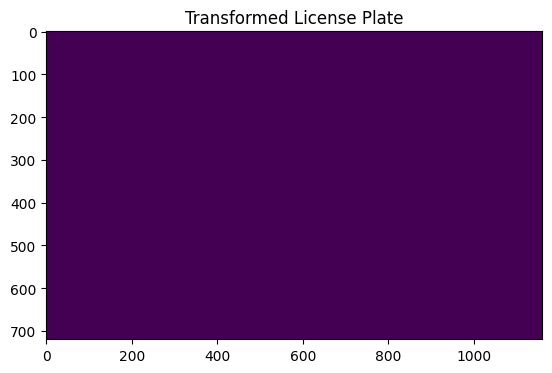

In [18]:
# 对原图进行透视变换
i = 0

my_train_img = []
my_val_img = []
my_test_img = []

for img, mapped_corners in zip(train_img, train_corners):
  img = get_rotate_crop_image(img, np.float32(mapped_corners))
  my_train_img.append(img)
  i = i + 1
  if i < 10:
    plt.imshow(img)
    plt.title("Transformed License Plate")
    plt.show()

for img, mapped_corners in zip(val_img, val_corners):
  img = get_rotate_crop_image(img, np.float32(mapped_corners))
  my_val_img.append(img)

for img, mapped_corners in zip(test_img, test_corners):
  img = get_rotate_crop_image(img, np.float32(mapped_corners))
  my_test_img.append(img)

# **3 车牌内容识别**

## **3.1 数据**

In [19]:
train_img = true_train_img
train_labels = true_train_license_plate_numbers
val_img = true_val_img
val_labels = true_val_license_plate_numbers
test_img = true_test_img
test_labels = true_test_license_plate_numbers

### 3.1.1 定义字符到索引的映射

In [21]:
char_to_idx = {
    "皖": 28,"使": 0, "中": 29, "京": 1, "津": 2, "沪": 3, "渝": 4, "冀": 5, "豫": 6, "云": 7, "辽": 8, "黑": 9,
    "湘": 10, "鲁": 11, "新": 12, "苏": 13, "浙": 14, "闽": 15, "赣": 16, "琼": 17, "川": 18,
    "贵": 19, "陕": 20, "吉": 21, "桂": 22, "甘": 23, "蒙": 24, "青": 25, "藏": 26, "宁": 27,
    "港": 30, "澳": 31, "台": 32, "粤": 33,
    "鄂": 34,
    "闽": 35,
    'A': 36, 'B': 37, 'C': 38, 'D': 39, 'E': 40, 'F': 41, 'G': 42, 'H': 43, 'J': 44, 'K': 45,
    'L': 46, 'M': 47, 'N': 48, 'P': 49, 'Q': 50, 'R': 51, 'S': 52, 'T': 53, 'U': 54, 'V': 55,
    'W': 56, 'X': 57, 'Y': 58, 'Z': 59,  # 英文字母
    '0': 60, '1': 61, '2': 62, '3': 63, '4': 64, '5': 65, '6': 66, '7': 67, '8': 68, '9': 69  # 数字
}

# 反向字典：从索引到字符
idx_to_char = {idx: char for char, idx in char_to_idx.items()}

### 3.1.2 平衡数据集
&emsp;&emsp;根据先验知识，得知数据集是在合肥采集的（因为中科大在合肥），所以对于车牌号的第一位存在有很严重的类别不平衡情况，所以下面对非安徽车牌号进行数据增强处理。

In [22]:
# 数据增强：旋转
def augment_image(image):
  # 确保输入是二值图像（0和255）
  if not isinstance(image, np.ndarray):
      raise TypeError("输入图像必须是 numpy 数组")

  # 随机旋转
  angle = random.uniform(-10, 10)  # 旋转角度[-10, 10]度之间
  height, width = image.shape[:2]  # 获取图像的高度和宽度
  center = (width // 2, height // 2)  # 图像中心坐标 (x, y)

  # 获取旋转矩阵
  M = cv2.getRotationMatrix2D(center, angle, 1.0)
  rotated_img = cv2.warpAffine(image, M, (width, height), flags=cv2.INTER_NEAREST)  # 使用最近邻插值，保持二值性质

  return rotated_img

In [23]:
# 筛选出“皖”以外的车牌
train_others_img = []
train_others_labels = []
for img, label in zip(train_img, train_labels):
  #print(label, label[:1])
  if label[:1] != "皖":  # 车牌以"皖"开头的省份不进行增强
    train_others_img.append(img)
    train_others_labels.append(label)

# 对少数类别（即“皖”以外的车牌）进行数据增强
augmented_train_images = []
augmented_train_labels = []
for img, label in zip(train_others_img, train_others_labels):
  #print(type(img))

  for i in range(49):
    random.seed(i)
    augmented_img = augment_image(img)
    augmented_train_images.append(augmented_img)
    augmented_train_labels.append(label)

# 将增强后的数据和原始数据合并
train_img_balanced = train_img + augmented_train_images
train_labels_balanced = train_labels + augmented_train_labels

In [24]:
print(f"Number of training images: {len(train_img_balanced)}")
print(f"Number of training labels: {len(train_labels_balanced)}")

Number of training images: 6801
Number of training labels: 6801


### 3.1.3 数据集准备

In [25]:
class LicensePlateDataset(Dataset):
  def __init__(self, images, labels, transform=None):
    self.images = images  # 存储图像数据
    self.labels = labels  # 存储标签数据
    self.transform = transform  # 预处理操作

  def __len__(self):
    return len(self.images)

  def __getitem__(self, idx):
    if idx >= len(self.images) or idx < 0:
      print(f"Index {idx} is out of range.")
      raise IndexError(f"Index {idx} is out of range.")

    img = self.images[idx]
    label = self.labels[idx]

    label = [char_to_idx[char] for char in label]
    label = torch.tensor(label, dtype=torch.long)

    # 检查图像是否为空
    if img is None or img.size == 0:
      print(f"Index {idx} is out of range.")
      raise ValueError(f"Image at index {idx} is empty.")

    # 如果是灰度图像，将其转换为RGB
    if len(img.shape) == 2:  # 如果是灰度图
      img = np.stack([img] * 3, axis=-1)  # 转换为3通道（RGB）

    # 确保图像数据类型正确
    try:
      img = Image.fromarray(img.astype('uint8'), 'RGB')
    except Exception as e:
      raise ValueError(f"Error converting image at index {idx} to PIL Image: {e}")

    # 如果有transform，则进行转换
    if self.transform:
      img = self.transform(img)

    return img, label


&emsp;&emsp;这里要展示一下数据集集中尺寸以便统一。

Mode Image Size: 89x254
Second Mode Image Size: 79x214


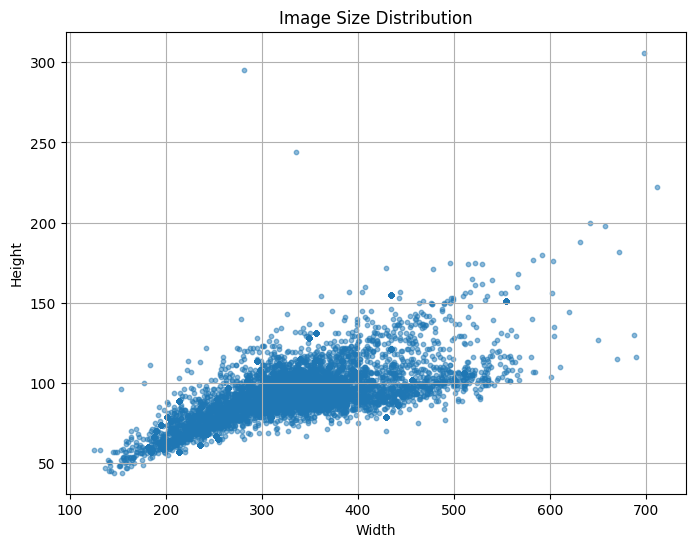

In [26]:
def get_mode_and_second_mode_size(*datasets):
    widths = []
    heights = []

    # 遍历所有数据集中的图像，收集宽度和高度
    for dataset in datasets:
        for img in dataset:
            height, width = img.shape[:2]
            heights.append(height)
            widths.append(width)

    # 统计宽度和高度的出现频率
    width_counter = Counter(widths)
    height_counter = Counter(heights)

    # 获取最常见的宽度和高度
    most_common_width, _ = width_counter.most_common(1)[0]
    most_common_height, _ = height_counter.most_common(1)[0]

    # 获取第二常见的宽度和高度（如果存在）
    second_common_width = width_counter.most_common(2)[1][0] if len(width_counter) > 1 else None
    second_common_height = height_counter.most_common(2)[1][0] if len(height_counter) > 1 else None

    return (most_common_height, most_common_width), (second_common_height, second_common_width)

# 获取所有数据集的图像尺寸众数和第二众数
(mode_height, mode_width), (second_mode_height, second_mode_width) = get_mode_and_second_mode_size(train_img_balanced, val_img, test_img)

print(f"Mode Image Size: {mode_height}x{mode_width}")
print(f"Second Mode Image Size: {second_mode_height}x{second_mode_width}")

# 获取图像尺寸并绘制散点图
def plot_image_size_scatter(*datasets):
    widths = []
    heights = []

    # 遍历所有数据集中的图像，收集宽度和高度
    for dataset in datasets:
        for img in dataset:
            height, width = img.shape[:2]
            heights.append(height)
            widths.append(width)

    # 绘制散点图，横坐标是宽度，纵坐标是高度
    plt.figure(figsize=(8, 6))
    plt.scatter(widths, heights, alpha=0.5, s=10)  # alpha 控制点的透明度，s 控制点的大小
    plt.title('Image Size Distribution')
    plt.xlabel('Width')
    plt.ylabel('Height')
    plt.grid(True)
    plt.show()

# 绘制所有数据集的图像尺寸散点图
plot_image_size_scatter(train_img_balanced, val_img, test_img)


&emsp;&emsp;根据刚刚得到的情况，编写transform，统一图像尺寸。

In [27]:
transform = transforms.Compose([
    transforms.Resize((254, 89)),  # 统一图像尺寸
    transforms.Grayscale(num_output_channels=1),  # 灰度图像
    transforms.ToTensor()  # 转换为Tensor
])

In [28]:
batch_size = 32

In [29]:
# 创建训练集、验证集和测试集的数据集
train_dataset_balanced = LicensePlateDataset(train_img_balanced, train_labels_balanced, transform=transform)
val_dataset = LicensePlateDataset(val_img, val_labels, transform=transform)
test_dataset = LicensePlateDataset(test_img, test_labels, transform=transform)

# 创建DataLoader
train_loader = DataLoader(train_dataset_balanced, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=1, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=1, shuffle=False)

## **3.2 模型**

In [30]:
seed = 3407
torch.manual_seed(seed)  # PyTorch CPU 的随机种子
torch.cuda.manual_seed(seed)  # PyTorch GPU 的随机种子
np.random.seed(seed)  # Numpy 的随机种子
random.seed(seed)

In [39]:
class LicensePlateCNN(nn.Module):
  def __init__(self, num_classes=70):
    super(LicensePlateCNN, self).__init__()

    # 卷积层部分
    self.conv1 = nn.Conv2d(1, 32, kernel_size=3, stride=1, padding=1)
    self.bn1 = nn.BatchNorm2d(32)
    self.conv2 = nn.Conv2d(32, 64, kernel_size=3, stride=1, padding=1)
    self.bn2 = nn.BatchNorm2d(64)
    self.conv3 = nn.Conv2d(64, 128, kernel_size=3, stride=1, padding=1)
    self.bn3 = nn.BatchNorm2d(128)
    self.conv4 = nn.Conv2d(128, 256, kernel_size=3, stride=1, padding=1)
    self.bn4 = nn.BatchNorm2d(256)

    # 池化层
    self.pool = nn.MaxPool2d(2, 2)

    # Dropout层
    self.dropout = nn.Dropout(p=0.5)

    # LSTM层
    self.lstm = nn.LSTM(input_size=256, hidden_size=128, num_layers=2, batch_first=True, bidirectional=True)

    # 全连接层
    self.fc = nn.Linear(128 * 2, num_classes)  # 双向LSTM，hidden_size * 2

  def forward(self, x):
    # 卷积和池化
    x = F.relu(self.bn1(self.conv1(x)))
    x = self.pool(x)
    x = F.relu(self.bn2(self.conv2(x)))
    x = self.pool(x)
    x = F.relu(self.bn3(self.conv3(x)))
    x = self.pool(x)
    x = F.relu(self.bn4(self.conv4(x)))
    x = self.pool(x)

    # Dropout层
    x = self.dropout(x)

    # 获取卷积输出的尺寸
    batch_size, channels, height, width = x.size()

    # 将输出展平为LSTM所需的输入格式: (batch_size, sequence_length, input_size)
    x = x.flatten(2).permute(0, 2, 1)  # (batch_size, width, channels * height)

    # LSTM处理序列特征
    x, _ = self.lstm(x)  # 输出 (batch_size, width, 128 * 2)

    # Dropout层
    x = self.dropout(x)

    # 最后通过全连接层得到类结果
    x = self.fc(x)  # (batch_size, seq_len, num_classes)

    return x

# 实例化模型
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = LicensePlateCNN(num_classes=70).to(device)

In [40]:
lr = 1e-3

In [41]:
# CTC损失
criterion = nn.CTCLoss()
# 优化器
optimizer = optim.Adam(model.parameters(), lr=lr, weight_decay=1e-5)
# 学习率调度器
scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, factor=0.1, patience=10, verbose=True)

/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


## **3.3 训练**

经过测试，epoch在200后就开始有过拟合的趋势。故设置190

In [42]:
writer = SummaryWriter('runs/CCPD')
epochs = 190

In [43]:
for epoch in range(epochs):
  print(f"Epoch [{epoch+1}/{epochs}]")

  # -------------------
  # 训练阶段
  # -------------------
  model.train()  # 设置为训练模式
  running_loss = 0.0

  for i, (x, y) in enumerate(tqdm(train_loader, desc="Training", unit="batch")):
    x = x.to(device)  # 将输入数据移动到GPU
    y = y.to(device)  # 将目标数据移动到GPU

    # 前向传播
    predictions = model(x)

    # 调整预测的形状为 (seq_len, batch_size, num_classes)
    batch_size = predictions.size(0)
    seq_len = predictions.size(1)
    predictions = predictions.permute(1, 0, 2)  # (seq_len, batch_size, num_classes)

    # 转换为 log_softmax 格式
    predictions = predictions.log_softmax(2)

    # 获取输入和目标的长度
    input_lengths = torch.full(size=(x.size(0),), fill_value=seq_len, dtype=torch.long).to(device)
    target_lengths = torch.full(size=(x.size(0),), fill_value=8, dtype=torch.long).to(device)

    # 计算 CTC 损失
    loss = criterion(predictions, y.view(-1), input_lengths, target_lengths)

    # 反向传播
    optimizer.zero_grad()  # 梯度清零
    loss.backward()        # 反向传播
    optimizer.step()       # 更新参数

    # 记录损失
    running_loss += loss.item()

  # 计算整个 epoch 的平均损失
  avg_loss = running_loss / len(train_loader)
  print(f"Epoch [{epoch+1}/{epochs}] Training Loss: {avg_loss:.6f}")

  # 将训练损失写入 TensorBoard
  writer.add_scalar('Loss/Train', avg_loss, epoch)

  # -------------------
  # 验证阶段
  # -------------------
  model.eval()  # 设置为评估模式
  val_loss = 0.0
  val_correct = 0
  val_samples = 0

  with torch.no_grad():  # 在验证阶段不计算梯度
    for x, y in tqdm(val_loader, desc="Validating", unit="batch"):
      x = x.to(device)
      y = y.to(device)

      # 前向传播
      predictions = model(x)

      # 调整预测的形状为 (seq_len, batch_size, num_classes)
      batch_size = predictions.size(0)
      seq_len = predictions.size(1)
      predictions = predictions.permute(1, 0, 2)  # (seq_len, batch_size, num_classes)

      # 转换为 log_softmax 格式
      predictions = predictions.log_softmax(2)

      # 获取输入和目标的长度
      input_lengths = torch.full(size=(x.size(0),), fill_value=seq_len, dtype=torch.long).to(device)
      target_lengths = torch.full(size=(x.size(0),), fill_value=8, dtype=torch.long).to(device)

      # 计算 CTC 损失
      loss = criterion(predictions, y.view(-1), input_lengths, target_lengths)

      # 记录验证损失
      val_loss += loss.item()

      # 使用 CTC 贪心解码
      decoded_preds = predictions.argmax(dim=2).transpose(0, 1)  # (batch_size, seq_len)

      # 逐样本比较预测结果与目标标签
      for i in range(batch_size):
        pred = decoded_preds[i].cpu().numpy()
        target = y[i].cpu().numpy()

        # 去除空白字符和重复字符
        pred_processed = []
        prev_char = None
        for char in pred:
            if char != 0 and char != prev_char:  # 去除空白字符和重复字符
                pred_processed.append(char)
            prev_char = char

        # 裁剪目标字符长度为 8
        target = target[:8]

        # 判断预测与目标是否完全匹配
        if len(pred_processed) == len(target) and pred_processed == list(target):
            val_correct += 1

      val_samples += y.size(0)

  # 计算验证集的平均损失和准确率
  avg_val_loss = val_loss / len(val_loader)
  val_accuracy = val_correct / val_samples
  print(f"Validation Loss: {avg_val_loss:.6f}, Accuracy: {val_accuracy:.6f}")

  # 将验证损失和准确率写入 TensorBoard
  writer.add_scalar('Loss/Validation', avg_val_loss, epoch)
  writer.add_scalar('Accuracy/Validation', val_accuracy, epoch)

writer.close()

Epoch [1/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.63batch/s]


Epoch [1/190] Training Loss: 3.415063


Validating: 100%|██████████| 432/432 [00:01<00:00, 286.91batch/s]


Validation Loss: 1.980405, Accuracy: 0.000000
Epoch [2/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.55batch/s]


Epoch [2/190] Training Loss: 1.981641


Validating: 100%|██████████| 432/432 [00:01<00:00, 287.14batch/s]


Validation Loss: 1.750715, Accuracy: 0.000000
Epoch [3/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.51batch/s]


Epoch [3/190] Training Loss: 1.804505


Validating: 100%|██████████| 432/432 [00:01<00:00, 292.03batch/s]


Validation Loss: 1.628027, Accuracy: 0.000000
Epoch [4/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.74batch/s]


Epoch [4/190] Training Loss: 1.648660


Validating: 100%|██████████| 432/432 [00:01<00:00, 293.09batch/s]


Validation Loss: 1.456337, Accuracy: 0.000000
Epoch [5/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.56batch/s]


Epoch [5/190] Training Loss: 1.454766


Validating: 100%|██████████| 432/432 [00:01<00:00, 287.49batch/s]


Validation Loss: 1.390009, Accuracy: 0.000000
Epoch [6/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.69batch/s]


Epoch [6/190] Training Loss: 1.267981


Validating: 100%|██████████| 432/432 [00:01<00:00, 281.22batch/s]


Validation Loss: 1.301571, Accuracy: 0.000000
Epoch [7/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.62batch/s]


Epoch [7/190] Training Loss: 1.080089


Validating: 100%|██████████| 432/432 [00:01<00:00, 287.13batch/s]


Validation Loss: 1.153002, Accuracy: 0.000000
Epoch [8/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.50batch/s]


Epoch [8/190] Training Loss: 0.927165


Validating: 100%|██████████| 432/432 [00:01<00:00, 288.77batch/s]


Validation Loss: 1.045891, Accuracy: 0.000000
Epoch [9/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.73batch/s]


Epoch [9/190] Training Loss: 0.794484


Validating: 100%|██████████| 432/432 [00:01<00:00, 287.70batch/s]


Validation Loss: 0.906674, Accuracy: 0.000000
Epoch [10/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.63batch/s]


Epoch [10/190] Training Loss: 0.686472


Validating: 100%|██████████| 432/432 [00:01<00:00, 290.19batch/s]


Validation Loss: 0.927406, Accuracy: 0.000000
Epoch [11/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.57batch/s]


Epoch [11/190] Training Loss: 0.608657


Validating: 100%|██████████| 432/432 [00:01<00:00, 284.77batch/s]


Validation Loss: 0.811899, Accuracy: 0.000000
Epoch [12/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.76batch/s]


Epoch [12/190] Training Loss: 0.558364


Validating: 100%|██████████| 432/432 [00:01<00:00, 287.52batch/s]


Validation Loss: 0.754706, Accuracy: 0.000000
Epoch [13/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.50batch/s]


Epoch [13/190] Training Loss: 0.501990


Validating: 100%|██████████| 432/432 [00:01<00:00, 283.25batch/s]


Validation Loss: 0.661126, Accuracy: 0.002315
Epoch [14/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.64batch/s]


Epoch [14/190] Training Loss: 0.458066


Validating: 100%|██████████| 432/432 [00:01<00:00, 288.13batch/s]


Validation Loss: 0.621016, Accuracy: 0.027778
Epoch [15/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.63batch/s]


Epoch [15/190] Training Loss: 0.427546


Validating: 100%|██████████| 432/432 [00:01<00:00, 288.96batch/s]


Validation Loss: 0.558589, Accuracy: 0.074074
Epoch [16/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.54batch/s]


Epoch [16/190] Training Loss: 0.362286


Validating: 100%|██████████| 432/432 [00:01<00:00, 288.58batch/s]


Validation Loss: 0.511245, Accuracy: 0.083333
Epoch [17/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.80batch/s]


Epoch [17/190] Training Loss: 0.327926


Validating: 100%|██████████| 432/432 [00:01<00:00, 290.44batch/s]


Validation Loss: 0.486897, Accuracy: 0.145833
Epoch [18/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.53batch/s]


Epoch [18/190] Training Loss: 0.283806


Validating: 100%|██████████| 432/432 [00:01<00:00, 281.82batch/s]


Validation Loss: 0.401769, Accuracy: 0.270833
Epoch [19/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.59batch/s]


Epoch [19/190] Training Loss: 0.239568


Validating: 100%|██████████| 432/432 [00:01<00:00, 286.30batch/s]


Validation Loss: 0.374724, Accuracy: 0.310185
Epoch [20/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.68batch/s]


Epoch [20/190] Training Loss: 0.218137


Validating: 100%|██████████| 432/432 [00:01<00:00, 288.69batch/s]


Validation Loss: 0.375972, Accuracy: 0.365741
Epoch [21/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.53batch/s]


Epoch [21/190] Training Loss: 0.186907


Validating: 100%|██████████| 432/432 [00:01<00:00, 289.37batch/s]


Validation Loss: 0.321507, Accuracy: 0.428241
Epoch [22/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.75batch/s]


Epoch [22/190] Training Loss: 0.182105


Validating: 100%|██████████| 432/432 [00:01<00:00, 286.22batch/s]


Validation Loss: 0.290812, Accuracy: 0.481481
Epoch [23/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.57batch/s]


Epoch [23/190] Training Loss: 0.180947


Validating: 100%|██████████| 432/432 [00:01<00:00, 287.04batch/s]


Validation Loss: 0.285049, Accuracy: 0.511574
Epoch [24/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.63batch/s]


Epoch [24/190] Training Loss: 0.159011


Validating: 100%|██████████| 432/432 [00:01<00:00, 291.06batch/s]


Validation Loss: 0.271187, Accuracy: 0.567130
Epoch [25/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.72batch/s]


Epoch [25/190] Training Loss: 0.143193


Validating: 100%|██████████| 432/432 [00:01<00:00, 276.91batch/s]


Validation Loss: 0.245789, Accuracy: 0.557870
Epoch [26/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.47batch/s]


Epoch [26/190] Training Loss: 0.122476


Validating: 100%|██████████| 432/432 [00:01<00:00, 286.12batch/s]


Validation Loss: 0.249151, Accuracy: 0.569444
Epoch [27/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.73batch/s]


Epoch [27/190] Training Loss: 0.121001


Validating: 100%|██████████| 432/432 [00:01<00:00, 289.83batch/s]


Validation Loss: 0.253401, Accuracy: 0.597222
Epoch [28/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.66batch/s]


Epoch [28/190] Training Loss: 0.129086


Validating: 100%|██████████| 432/432 [00:01<00:00, 286.95batch/s]


Validation Loss: 0.239701, Accuracy: 0.604167
Epoch [29/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.48batch/s]


Epoch [29/190] Training Loss: 0.119640


Validating: 100%|██████████| 432/432 [00:01<00:00, 291.18batch/s]


Validation Loss: 0.222794, Accuracy: 0.643519
Epoch [30/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.77batch/s]


Epoch [30/190] Training Loss: 0.115286


Validating: 100%|██████████| 432/432 [00:01<00:00, 288.82batch/s]


Validation Loss: 0.205471, Accuracy: 0.712963
Epoch [31/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.49batch/s]


Epoch [31/190] Training Loss: 0.097578


Validating: 100%|██████████| 432/432 [00:01<00:00, 282.36batch/s]


Validation Loss: 0.189191, Accuracy: 0.733796
Epoch [32/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.59batch/s]


Epoch [32/190] Training Loss: 0.086942


Validating: 100%|██████████| 432/432 [00:01<00:00, 287.09batch/s]


Validation Loss: 0.224024, Accuracy: 0.668981
Epoch [33/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.68batch/s]


Epoch [33/190] Training Loss: 0.153294


Validating: 100%|██████████| 432/432 [00:01<00:00, 286.76batch/s]


Validation Loss: 0.234507, Accuracy: 0.655093
Epoch [34/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.46batch/s]


Epoch [34/190] Training Loss: 0.091529


Validating: 100%|██████████| 432/432 [00:01<00:00, 284.17batch/s]


Validation Loss: 0.208495, Accuracy: 0.694444
Epoch [35/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.61batch/s]


Epoch [35/190] Training Loss: 0.096033


Validating: 100%|██████████| 432/432 [00:01<00:00, 265.87batch/s]


Validation Loss: 0.197811, Accuracy: 0.773148
Epoch [36/190]


Training: 100%|██████████| 213/213 [00:13<00:00, 15.86batch/s]


Epoch [36/190] Training Loss: 0.081593


Validating: 100%|██████████| 432/432 [00:01<00:00, 259.79batch/s]


Validation Loss: 0.174727, Accuracy: 0.761574
Epoch [37/190]


Training: 100%|██████████| 213/213 [00:13<00:00, 15.90batch/s]


Epoch [37/190] Training Loss: 0.084438


Validating: 100%|██████████| 432/432 [00:01<00:00, 253.50batch/s]


Validation Loss: 0.204163, Accuracy: 0.680556
Epoch [38/190]


Training: 100%|██████████| 213/213 [00:13<00:00, 15.91batch/s]


Epoch [38/190] Training Loss: 0.085159


Validating: 100%|██████████| 432/432 [00:01<00:00, 264.08batch/s]


Validation Loss: 0.179645, Accuracy: 0.754630
Epoch [39/190]


Training: 100%|██████████| 213/213 [00:13<00:00, 15.94batch/s]


Epoch [39/190] Training Loss: 0.092847


Validating: 100%|██████████| 432/432 [00:01<00:00, 263.42batch/s]


Validation Loss: 0.225118, Accuracy: 0.694444
Epoch [40/190]


Training: 100%|██████████| 213/213 [00:13<00:00, 15.96batch/s]


Epoch [40/190] Training Loss: 0.112757


Validating: 100%|██████████| 432/432 [00:01<00:00, 262.34batch/s]


Validation Loss: 0.202321, Accuracy: 0.731481
Epoch [41/190]


Training: 100%|██████████| 213/213 [00:13<00:00, 15.95batch/s]


Epoch [41/190] Training Loss: 0.097617


Validating: 100%|██████████| 432/432 [00:01<00:00, 251.54batch/s]


Validation Loss: 0.182521, Accuracy: 0.773148
Epoch [42/190]


Training: 100%|██████████| 213/213 [00:13<00:00, 15.91batch/s]


Epoch [42/190] Training Loss: 0.086911


Validating: 100%|██████████| 432/432 [00:01<00:00, 261.36batch/s]


Validation Loss: 0.191591, Accuracy: 0.759259
Epoch [43/190]


Training: 100%|██████████| 213/213 [00:13<00:00, 15.91batch/s]


Epoch [43/190] Training Loss: 0.089973


Validating: 100%|██████████| 432/432 [00:01<00:00, 260.15batch/s]


Validation Loss: 0.184498, Accuracy: 0.736111
Epoch [44/190]


Training: 100%|██████████| 213/213 [00:13<00:00, 15.91batch/s]


Epoch [44/190] Training Loss: 0.075206


Validating: 100%|██████████| 432/432 [00:01<00:00, 259.91batch/s]


Validation Loss: 0.157121, Accuracy: 0.796296
Epoch [45/190]


Training: 100%|██████████| 213/213 [00:13<00:00, 15.88batch/s]


Epoch [45/190] Training Loss: 0.072443


Validating: 100%|██████████| 432/432 [00:01<00:00, 259.94batch/s]


Validation Loss: 0.153437, Accuracy: 0.814815
Epoch [46/190]


Training: 100%|██████████| 213/213 [00:13<00:00, 15.91batch/s]


Epoch [46/190] Training Loss: 0.102113


Validating: 100%|██████████| 432/432 [00:01<00:00, 263.70batch/s]


Validation Loss: 0.181166, Accuracy: 0.756944
Epoch [47/190]


Training: 100%|██████████| 213/213 [00:13<00:00, 15.95batch/s]


Epoch [47/190] Training Loss: 0.100373


Validating: 100%|██████████| 432/432 [00:01<00:00, 263.33batch/s]


Validation Loss: 0.184997, Accuracy: 0.740741
Epoch [48/190]


Training: 100%|██████████| 213/213 [00:13<00:00, 15.96batch/s]


Epoch [48/190] Training Loss: 0.089667


Validating: 100%|██████████| 432/432 [00:01<00:00, 262.70batch/s]


Validation Loss: 0.184113, Accuracy: 0.768519
Epoch [49/190]


Training: 100%|██████████| 213/213 [00:13<00:00, 15.93batch/s]


Epoch [49/190] Training Loss: 0.075867


Validating: 100%|██████████| 432/432 [00:01<00:00, 256.34batch/s]


Validation Loss: 0.183763, Accuracy: 0.750000
Epoch [50/190]


Training: 100%|██████████| 213/213 [00:13<00:00, 16.03batch/s]


Epoch [50/190] Training Loss: 0.073660


Validating: 100%|██████████| 432/432 [00:01<00:00, 257.77batch/s]


Validation Loss: 0.159194, Accuracy: 0.789352
Epoch [51/190]


Training: 100%|██████████| 213/213 [00:13<00:00, 15.90batch/s]


Epoch [51/190] Training Loss: 0.068869


Validating: 100%|██████████| 432/432 [00:01<00:00, 256.14batch/s]


Validation Loss: 0.144710, Accuracy: 0.826389
Epoch [52/190]


Training: 100%|██████████| 213/213 [00:13<00:00, 15.90batch/s]


Epoch [52/190] Training Loss: 0.068942


Validating: 100%|██████████| 432/432 [00:01<00:00, 257.71batch/s]


Validation Loss: 0.179132, Accuracy: 0.763889
Epoch [53/190]


Training: 100%|██████████| 213/213 [00:13<00:00, 15.98batch/s]


Epoch [53/190] Training Loss: 0.059758


Validating: 100%|██████████| 432/432 [00:01<00:00, 262.13batch/s]


Validation Loss: 0.162409, Accuracy: 0.803241
Epoch [54/190]


Training: 100%|██████████| 213/213 [00:13<00:00, 15.94batch/s]


Epoch [54/190] Training Loss: 0.060977


Validating: 100%|██████████| 432/432 [00:01<00:00, 258.83batch/s]


Validation Loss: 0.149315, Accuracy: 0.826389
Epoch [55/190]


Training: 100%|██████████| 213/213 [00:13<00:00, 15.98batch/s]


Epoch [55/190] Training Loss: 0.444846


Validating: 100%|██████████| 432/432 [00:01<00:00, 261.23batch/s]


Validation Loss: 0.563870, Accuracy: 0.067130
Epoch [56/190]


Training: 100%|██████████| 213/213 [00:13<00:00, 15.84batch/s]


Epoch [56/190] Training Loss: 0.294228


Validating: 100%|██████████| 432/432 [00:01<00:00, 250.73batch/s]


Validation Loss: 0.337923, Accuracy: 0.409722
Epoch [57/190]


Training: 100%|██████████| 213/213 [00:13<00:00, 15.90batch/s]


Epoch [57/190] Training Loss: 0.170679


Validating: 100%|██████████| 432/432 [00:01<00:00, 261.56batch/s]


Validation Loss: 0.244191, Accuracy: 0.594907
Epoch [58/190]


Training: 100%|██████████| 213/213 [00:13<00:00, 15.91batch/s]


Epoch [58/190] Training Loss: 0.122631


Validating: 100%|██████████| 432/432 [00:01<00:00, 264.50batch/s]


Validation Loss: 0.197884, Accuracy: 0.722222
Epoch [59/190]


Training: 100%|██████████| 213/213 [00:13<00:00, 15.90batch/s]


Epoch [59/190] Training Loss: 0.099087


Validating: 100%|██████████| 432/432 [00:01<00:00, 256.54batch/s]


Validation Loss: 0.199756, Accuracy: 0.694444
Epoch [60/190]


Training: 100%|██████████| 213/213 [00:13<00:00, 15.87batch/s]


Epoch [60/190] Training Loss: 0.081616


Validating: 100%|██████████| 432/432 [00:01<00:00, 261.29batch/s]


Validation Loss: 0.181250, Accuracy: 0.763889
Epoch [61/190]


Training: 100%|██████████| 213/213 [00:13<00:00, 15.99batch/s]


Epoch [61/190] Training Loss: 0.075532


Validating: 100%|██████████| 432/432 [00:01<00:00, 251.52batch/s]


Validation Loss: 0.215479, Accuracy: 0.710648
Epoch [62/190]


Training: 100%|██████████| 213/213 [00:13<00:00, 15.91batch/s]


Epoch [62/190] Training Loss: 0.070787


Validating: 100%|██████████| 432/432 [00:01<00:00, 260.84batch/s]


Validation Loss: 0.148561, Accuracy: 0.819444
Epoch [63/190]


Training: 100%|██████████| 213/213 [00:13<00:00, 15.92batch/s]


Epoch [63/190] Training Loss: 0.051585


Validating: 100%|██████████| 432/432 [00:01<00:00, 262.72batch/s]


Validation Loss: 0.166868, Accuracy: 0.812500
Epoch [64/190]


Training: 100%|██████████| 213/213 [00:13<00:00, 15.93batch/s]


Epoch [64/190] Training Loss: 0.058233


Validating: 100%|██████████| 432/432 [00:01<00:00, 274.49batch/s]


Validation Loss: 0.150437, Accuracy: 0.819444
Epoch [65/190]


Training: 100%|██████████| 213/213 [00:13<00:00, 15.93batch/s]


Epoch [65/190] Training Loss: 0.050995


Validating: 100%|██████████| 432/432 [00:01<00:00, 261.83batch/s]


Validation Loss: 0.168824, Accuracy: 0.819444
Epoch [66/190]


Training: 100%|██████████| 213/213 [00:13<00:00, 15.93batch/s]


Epoch [66/190] Training Loss: 0.043398


Validating: 100%|██████████| 432/432 [00:01<00:00, 251.90batch/s]


Validation Loss: 0.161346, Accuracy: 0.842593
Epoch [67/190]


Training: 100%|██████████| 213/213 [00:13<00:00, 15.96batch/s]


Epoch [67/190] Training Loss: 0.047320


Validating: 100%|██████████| 432/432 [00:01<00:00, 259.12batch/s]


Validation Loss: 0.149730, Accuracy: 0.856481
Epoch [68/190]


Training: 100%|██████████| 213/213 [00:13<00:00, 15.95batch/s]


Epoch [68/190] Training Loss: 0.042176


Validating: 100%|██████████| 432/432 [00:01<00:00, 260.74batch/s]


Validation Loss: 0.143313, Accuracy: 0.842593
Epoch [69/190]


Training: 100%|██████████| 213/213 [00:13<00:00, 15.94batch/s]


Epoch [69/190] Training Loss: 0.040142


Validating: 100%|██████████| 432/432 [00:01<00:00, 255.50batch/s]


Validation Loss: 0.157251, Accuracy: 0.835648
Epoch [70/190]


Training: 100%|██████████| 213/213 [00:13<00:00, 15.91batch/s]


Epoch [70/190] Training Loss: 0.035143


Validating: 100%|██████████| 432/432 [00:01<00:00, 254.17batch/s]


Validation Loss: 0.146804, Accuracy: 0.865741
Epoch [71/190]


Training: 100%|██████████| 213/213 [00:13<00:00, 15.90batch/s]


Epoch [71/190] Training Loss: 0.035018


Validating: 100%|██████████| 432/432 [00:01<00:00, 261.33batch/s]


Validation Loss: 0.139516, Accuracy: 0.854167
Epoch [72/190]


Training: 100%|██████████| 213/213 [00:13<00:00, 15.92batch/s]


Epoch [72/190] Training Loss: 0.037722


Validating: 100%|██████████| 432/432 [00:01<00:00, 260.47batch/s]


Validation Loss: 0.128663, Accuracy: 0.856481
Epoch [73/190]


Training: 100%|██████████| 213/213 [00:13<00:00, 15.95batch/s]


Epoch [73/190] Training Loss: 0.038040


Validating: 100%|██████████| 432/432 [00:01<00:00, 262.49batch/s]


Validation Loss: 0.140928, Accuracy: 0.865741
Epoch [74/190]


Training: 100%|██████████| 213/213 [00:13<00:00, 15.89batch/s]


Epoch [74/190] Training Loss: 0.034180


Validating: 100%|██████████| 432/432 [00:01<00:00, 258.02batch/s]


Validation Loss: 0.147429, Accuracy: 0.858796
Epoch [75/190]


Training: 100%|██████████| 213/213 [00:13<00:00, 15.97batch/s]


Epoch [75/190] Training Loss: 0.036349


Validating: 100%|██████████| 432/432 [00:01<00:00, 250.33batch/s]


Validation Loss: 0.133687, Accuracy: 0.881944
Epoch [76/190]


Training: 100%|██████████| 213/213 [00:13<00:00, 15.92batch/s]


Epoch [76/190] Training Loss: 0.039836


Validating: 100%|██████████| 432/432 [00:01<00:00, 262.64batch/s]


Validation Loss: 0.136180, Accuracy: 0.868056
Epoch [77/190]


Training: 100%|██████████| 213/213 [00:13<00:00, 15.86batch/s]


Epoch [77/190] Training Loss: 0.033445


Validating: 100%|██████████| 432/432 [00:01<00:00, 256.28batch/s]


Validation Loss: 0.151662, Accuracy: 0.863426
Epoch [78/190]


Training: 100%|██████████| 213/213 [00:13<00:00, 15.94batch/s]


Epoch [78/190] Training Loss: 0.061665


Validating: 100%|██████████| 432/432 [00:01<00:00, 260.97batch/s]


Validation Loss: 0.135216, Accuracy: 0.870370
Epoch [79/190]


Training: 100%|██████████| 213/213 [00:13<00:00, 15.97batch/s]


Epoch [79/190] Training Loss: 0.038508


Validating: 100%|██████████| 432/432 [00:01<00:00, 259.07batch/s]


Validation Loss: 0.143244, Accuracy: 0.847222
Epoch [80/190]


Training: 100%|██████████| 213/213 [00:13<00:00, 16.12batch/s]


Epoch [80/190] Training Loss: 0.031502


Validating: 100%|██████████| 432/432 [00:01<00:00, 285.40batch/s]


Validation Loss: 0.126530, Accuracy: 0.886574
Epoch [81/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.74batch/s]


Epoch [81/190] Training Loss: 0.052295


Validating: 100%|██████████| 432/432 [00:01<00:00, 290.64batch/s]


Validation Loss: 0.146582, Accuracy: 0.849537
Epoch [82/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.59batch/s]


Epoch [82/190] Training Loss: 0.046078


Validating: 100%|██████████| 432/432 [00:01<00:00, 285.61batch/s]


Validation Loss: 0.162957, Accuracy: 0.810185
Epoch [83/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.66batch/s]


Epoch [83/190] Training Loss: 0.086357


Validating: 100%|██████████| 432/432 [00:01<00:00, 289.04batch/s]


Validation Loss: 0.139140, Accuracy: 0.856481
Epoch [84/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.73batch/s]


Epoch [84/190] Training Loss: 0.044278


Validating: 100%|██████████| 432/432 [00:01<00:00, 283.61batch/s]


Validation Loss: 0.156558, Accuracy: 0.812500
Epoch [85/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.50batch/s]


Epoch [85/190] Training Loss: 0.064376


Validating: 100%|██████████| 432/432 [00:01<00:00, 288.53batch/s]


Validation Loss: 0.145885, Accuracy: 0.840278
Epoch [86/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.72batch/s]


Epoch [86/190] Training Loss: 0.072472


Validating: 100%|██████████| 432/432 [00:01<00:00, 281.14batch/s]


Validation Loss: 0.155287, Accuracy: 0.856481
Epoch [87/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.54batch/s]


Epoch [87/190] Training Loss: 0.046288


Validating: 100%|██████████| 432/432 [00:01<00:00, 282.95batch/s]


Validation Loss: 0.148951, Accuracy: 0.858796
Epoch [88/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.65batch/s]


Epoch [88/190] Training Loss: 0.042075


Validating: 100%|██████████| 432/432 [00:01<00:00, 286.40batch/s]


Validation Loss: 0.285834, Accuracy: 0.641204
Epoch [89/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.77batch/s]


Epoch [89/190] Training Loss: 0.056396


Validating: 100%|██████████| 432/432 [00:01<00:00, 289.84batch/s]


Validation Loss: 0.168220, Accuracy: 0.865741
Epoch [90/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.51batch/s]


Epoch [90/190] Training Loss: 0.075316


Validating: 100%|██████████| 432/432 [00:01<00:00, 286.75batch/s]


Validation Loss: 0.194160, Accuracy: 0.782407
Epoch [91/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.65batch/s]


Epoch [91/190] Training Loss: 0.050667


Validating: 100%|██████████| 432/432 [00:01<00:00, 290.48batch/s]


Validation Loss: 0.144234, Accuracy: 0.872685
Epoch [92/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.59batch/s]


Epoch [92/190] Training Loss: 0.057792


Validating: 100%|██████████| 432/432 [00:01<00:00, 283.92batch/s]


Validation Loss: 0.143016, Accuracy: 0.879630
Epoch [93/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.51batch/s]


Epoch [93/190] Training Loss: 0.034584


Validating: 100%|██████████| 432/432 [00:01<00:00, 283.45batch/s]


Validation Loss: 0.192287, Accuracy: 0.787037
Epoch [94/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.62batch/s]


Epoch [94/190] Training Loss: 0.075675


Validating: 100%|██████████| 432/432 [00:01<00:00, 288.91batch/s]


Validation Loss: 0.298561, Accuracy: 0.634259
Epoch [95/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.47batch/s]


Epoch [95/190] Training Loss: 0.059928


Validating: 100%|██████████| 432/432 [00:01<00:00, 286.21batch/s]


Validation Loss: 0.145970, Accuracy: 0.886574
Epoch [96/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.52batch/s]


Epoch [96/190] Training Loss: 0.034017


Validating: 100%|██████████| 432/432 [00:01<00:00, 288.74batch/s]


Validation Loss: 0.139794, Accuracy: 0.870370
Epoch [97/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.56batch/s]


Epoch [97/190] Training Loss: 0.057431


Validating: 100%|██████████| 432/432 [00:01<00:00, 286.76batch/s]


Validation Loss: 0.147698, Accuracy: 0.877315
Epoch [98/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.46batch/s]


Epoch [98/190] Training Loss: 0.037956


Validating: 100%|██████████| 432/432 [00:01<00:00, 283.90batch/s]


Validation Loss: 0.145711, Accuracy: 0.884259
Epoch [99/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.54batch/s]


Epoch [99/190] Training Loss: 0.060509


Validating: 100%|██████████| 432/432 [00:01<00:00, 288.60batch/s]


Validation Loss: 0.146698, Accuracy: 0.875000
Epoch [100/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.49batch/s]


Epoch [100/190] Training Loss: 0.056888


Validating: 100%|██████████| 432/432 [00:01<00:00, 284.00batch/s]


Validation Loss: 0.148255, Accuracy: 0.872685
Epoch [101/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.52batch/s]


Epoch [101/190] Training Loss: 0.066434


Validating: 100%|██████████| 432/432 [00:01<00:00, 285.45batch/s]


Validation Loss: 0.167104, Accuracy: 0.833333
Epoch [102/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.55batch/s]


Epoch [102/190] Training Loss: 0.057939


Validating: 100%|██████████| 432/432 [00:01<00:00, 285.92batch/s]


Validation Loss: 0.135290, Accuracy: 0.842593
Epoch [103/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.39batch/s]


Epoch [103/190] Training Loss: 0.038253


Validating: 100%|██████████| 432/432 [00:01<00:00, 283.21batch/s]


Validation Loss: 0.146631, Accuracy: 0.879630
Epoch [104/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.59batch/s]


Epoch [104/190] Training Loss: 0.029540


Validating: 100%|██████████| 432/432 [00:01<00:00, 286.02batch/s]


Validation Loss: 0.143362, Accuracy: 0.875000
Epoch [105/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.48batch/s]


Epoch [105/190] Training Loss: 0.065913


Validating: 100%|██████████| 432/432 [00:01<00:00, 284.84batch/s]


Validation Loss: 0.143053, Accuracy: 0.888889
Epoch [106/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.51batch/s]


Epoch [106/190] Training Loss: 0.046172


Validating: 100%|██████████| 432/432 [00:01<00:00, 291.33batch/s]


Validation Loss: 0.143660, Accuracy: 0.854167
Epoch [107/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.64batch/s]


Epoch [107/190] Training Loss: 0.083020


Validating: 100%|██████████| 432/432 [00:01<00:00, 285.67batch/s]


Validation Loss: 0.120283, Accuracy: 0.870370
Epoch [108/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.48batch/s]


Epoch [108/190] Training Loss: 0.036529


Validating: 100%|██████████| 432/432 [00:01<00:00, 287.50batch/s]


Validation Loss: 0.123422, Accuracy: 0.877315
Epoch [109/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.68batch/s]


Epoch [109/190] Training Loss: 0.028704


Validating: 100%|██████████| 432/432 [00:01<00:00, 284.74batch/s]


Validation Loss: 0.112937, Accuracy: 0.893519
Epoch [110/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.47batch/s]


Epoch [110/190] Training Loss: 0.067587


Validating: 100%|██████████| 432/432 [00:01<00:00, 282.61batch/s]


Validation Loss: 0.128752, Accuracy: 0.875000
Epoch [111/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.47batch/s]


Epoch [111/190] Training Loss: 0.037315


Validating: 100%|██████████| 432/432 [00:01<00:00, 286.76batch/s]


Validation Loss: 0.121340, Accuracy: 0.863426
Epoch [112/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.65batch/s]


Epoch [112/190] Training Loss: 0.040755


Validating: 100%|██████████| 432/432 [00:01<00:00, 288.46batch/s]


Validation Loss: 0.129086, Accuracy: 0.886574
Epoch [113/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.47batch/s]


Epoch [113/190] Training Loss: 0.060515


Validating: 100%|██████████| 432/432 [00:01<00:00, 286.63batch/s]


Validation Loss: 0.137372, Accuracy: 0.870370
Epoch [114/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.61batch/s]


Epoch [114/190] Training Loss: 0.040723


Validating: 100%|██████████| 432/432 [00:01<00:00, 289.37batch/s]


Validation Loss: 0.128024, Accuracy: 0.884259
Epoch [115/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.61batch/s]


Epoch [115/190] Training Loss: 0.044723


Validating: 100%|██████████| 432/432 [00:01<00:00, 288.18batch/s]


Validation Loss: 0.127185, Accuracy: 0.879630
Epoch [116/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.50batch/s]


Epoch [116/190] Training Loss: 0.046345


Validating: 100%|██████████| 432/432 [00:01<00:00, 285.33batch/s]


Validation Loss: 0.105005, Accuracy: 0.905093
Epoch [117/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.62batch/s]


Epoch [117/190] Training Loss: 0.044847


Validating: 100%|██████████| 432/432 [00:01<00:00, 287.63batch/s]


Validation Loss: 0.119940, Accuracy: 0.895833
Epoch [118/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.51batch/s]


Epoch [118/190] Training Loss: 0.065497


Validating: 100%|██████████| 432/432 [00:01<00:00, 283.00batch/s]


Validation Loss: 0.137810, Accuracy: 0.812500
Epoch [119/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.53batch/s]


Epoch [119/190] Training Loss: 0.056382


Validating: 100%|██████████| 432/432 [00:01<00:00, 283.78batch/s]


Validation Loss: 0.128228, Accuracy: 0.870370
Epoch [120/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.56batch/s]


Epoch [120/190] Training Loss: 0.057788


Validating: 100%|██████████| 432/432 [00:01<00:00, 285.27batch/s]


Validation Loss: 0.181957, Accuracy: 0.787037
Epoch [121/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.48batch/s]


Epoch [121/190] Training Loss: 0.071558


Validating: 100%|██████████| 432/432 [00:01<00:00, 288.73batch/s]


Validation Loss: 0.170963, Accuracy: 0.798611
Epoch [122/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.63batch/s]


Epoch [122/190] Training Loss: 0.053892


Validating: 100%|██████████| 432/432 [00:01<00:00, 283.47batch/s]


Validation Loss: 0.148528, Accuracy: 0.851852
Epoch [123/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.54batch/s]


Epoch [123/190] Training Loss: 0.055211


Validating: 100%|██████████| 432/432 [00:01<00:00, 286.46batch/s]


Validation Loss: 0.126879, Accuracy: 0.879630
Epoch [124/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.59batch/s]


Epoch [124/190] Training Loss: 0.071337


Validating: 100%|██████████| 432/432 [00:01<00:00, 289.24batch/s]


Validation Loss: 0.157473, Accuracy: 0.814815
Epoch [125/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.70batch/s]


Epoch [125/190] Training Loss: 0.064217


Validating: 100%|██████████| 432/432 [00:01<00:00, 290.18batch/s]


Validation Loss: 0.146112, Accuracy: 0.844907
Epoch [126/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.41batch/s]


Epoch [126/190] Training Loss: 0.081188


Validating: 100%|██████████| 432/432 [00:01<00:00, 291.04batch/s]


Validation Loss: 0.132962, Accuracy: 0.865741
Epoch [127/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.75batch/s]


Epoch [127/190] Training Loss: 0.093900


Validating: 100%|██████████| 432/432 [00:01<00:00, 290.10batch/s]


Validation Loss: 0.258366, Accuracy: 0.604167
Epoch [128/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.56batch/s]


Epoch [128/190] Training Loss: 0.073593


Validating: 100%|██████████| 432/432 [00:01<00:00, 279.92batch/s]


Validation Loss: 0.159962, Accuracy: 0.803241
Epoch [129/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.59batch/s]


Epoch [129/190] Training Loss: 0.124164


Validating: 100%|██████████| 432/432 [00:01<00:00, 290.42batch/s]


Validation Loss: 0.186079, Accuracy: 0.784722
Epoch [130/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.73batch/s]


Epoch [130/190] Training Loss: 0.097144


Validating: 100%|██████████| 432/432 [00:01<00:00, 288.25batch/s]


Validation Loss: 0.165350, Accuracy: 0.780093
Epoch [131/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.57batch/s]


Epoch [131/190] Training Loss: 0.055665


Validating: 100%|██████████| 432/432 [00:01<00:00, 287.12batch/s]


Validation Loss: 0.150873, Accuracy: 0.844907
Epoch [132/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.68batch/s]


Epoch [132/190] Training Loss: 0.089225


Validating: 100%|██████████| 432/432 [00:01<00:00, 290.15batch/s]


Validation Loss: 0.194291, Accuracy: 0.736111
Epoch [133/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.59batch/s]


Epoch [133/190] Training Loss: 0.096047


Validating: 100%|██████████| 432/432 [00:01<00:00, 287.33batch/s]


Validation Loss: 0.174237, Accuracy: 0.770833
Epoch [134/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.54batch/s]


Epoch [134/190] Training Loss: 0.062119


Validating: 100%|██████████| 432/432 [00:01<00:00, 274.09batch/s]


Validation Loss: 0.149213, Accuracy: 0.847222
Epoch [135/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.64batch/s]


Epoch [135/190] Training Loss: 0.123089


Validating: 100%|██████████| 432/432 [00:01<00:00, 284.78batch/s]


Validation Loss: 0.160057, Accuracy: 0.768519
Epoch [136/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.58batch/s]


Epoch [136/190] Training Loss: 0.088253


Validating: 100%|██████████| 432/432 [00:01<00:00, 286.28batch/s]


Validation Loss: 0.166664, Accuracy: 0.770833
Epoch [137/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.72batch/s]


Epoch [137/190] Training Loss: 0.073852


Validating: 100%|██████████| 432/432 [00:01<00:00, 291.20batch/s]


Validation Loss: 0.128334, Accuracy: 0.861111
Epoch [138/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.74batch/s]


Epoch [138/190] Training Loss: 0.041766


Validating: 100%|██████████| 432/432 [00:01<00:00, 287.42batch/s]


Validation Loss: 0.111769, Accuracy: 0.879630
Epoch [139/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.48batch/s]


Epoch [139/190] Training Loss: 0.026911


Validating: 100%|██████████| 432/432 [00:01<00:00, 290.05batch/s]


Validation Loss: 0.124117, Accuracy: 0.888889
Epoch [140/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.70batch/s]


Epoch [140/190] Training Loss: 0.029966


Validating: 100%|██████████| 432/432 [00:01<00:00, 289.68batch/s]


Validation Loss: 0.115775, Accuracy: 0.888889
Epoch [141/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.45batch/s]


Epoch [141/190] Training Loss: 0.021550


Validating: 100%|██████████| 432/432 [00:01<00:00, 275.36batch/s]


Validation Loss: 0.110708, Accuracy: 0.893519
Epoch [142/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.67batch/s]


Epoch [142/190] Training Loss: 0.019312


Validating: 100%|██████████| 432/432 [00:01<00:00, 286.35batch/s]


Validation Loss: 0.114104, Accuracy: 0.886574
Epoch [143/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.67batch/s]


Epoch [143/190] Training Loss: 0.015337


Validating: 100%|██████████| 432/432 [00:01<00:00, 287.53batch/s]


Validation Loss: 0.108676, Accuracy: 0.900463
Epoch [144/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.43batch/s]


Epoch [144/190] Training Loss: 0.014369


Validating: 100%|██████████| 432/432 [00:01<00:00, 290.18batch/s]


Validation Loss: 0.111347, Accuracy: 0.898148
Epoch [145/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.76batch/s]


Epoch [145/190] Training Loss: 0.014182


Validating: 100%|██████████| 432/432 [00:01<00:00, 290.10batch/s]


Validation Loss: 0.105573, Accuracy: 0.900463
Epoch [146/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.57batch/s]


Epoch [146/190] Training Loss: 0.011924


Validating: 100%|██████████| 432/432 [00:01<00:00, 290.96batch/s]


Validation Loss: 0.114555, Accuracy: 0.898148
Epoch [147/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.56batch/s]


Epoch [147/190] Training Loss: 0.013377


Validating: 100%|██████████| 432/432 [00:01<00:00, 280.90batch/s]


Validation Loss: 0.110434, Accuracy: 0.902778
Epoch [148/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.65batch/s]


Epoch [148/190] Training Loss: 0.011556


Validating: 100%|██████████| 432/432 [00:01<00:00, 285.86batch/s]


Validation Loss: 0.103061, Accuracy: 0.900463
Epoch [149/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.49batch/s]


Epoch [149/190] Training Loss: 0.046467


Validating: 100%|██████████| 432/432 [00:01<00:00, 282.71batch/s]


Validation Loss: 0.117428, Accuracy: 0.888889
Epoch [150/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.48batch/s]


Epoch [150/190] Training Loss: 0.069881


Validating: 100%|██████████| 432/432 [00:01<00:00, 284.62batch/s]


Validation Loss: 0.127633, Accuracy: 0.891204
Epoch [151/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.50batch/s]


Epoch [151/190] Training Loss: 0.071494


Validating: 100%|██████████| 432/432 [00:01<00:00, 288.95batch/s]


Validation Loss: 0.140315, Accuracy: 0.868056
Epoch [152/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.39batch/s]


Epoch [152/190] Training Loss: 0.031938


Validating: 100%|██████████| 432/432 [00:01<00:00, 289.52batch/s]


Validation Loss: 0.119757, Accuracy: 0.891204
Epoch [153/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.50batch/s]


Epoch [153/190] Training Loss: 0.105659


Validating: 100%|██████████| 432/432 [00:01<00:00, 279.81batch/s]


Validation Loss: 0.168229, Accuracy: 0.782407
Epoch [154/190]


Training: 100%|██████████| 213/213 [00:13<00:00, 16.36batch/s]


Epoch [154/190] Training Loss: 0.053622


Validating: 100%|██████████| 432/432 [00:01<00:00, 290.21batch/s]


Validation Loss: 0.111660, Accuracy: 0.893519
Epoch [155/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.49batch/s]


Epoch [155/190] Training Loss: 0.055469


Validating: 100%|██████████| 432/432 [00:01<00:00, 285.05batch/s]


Validation Loss: 0.161296, Accuracy: 0.833333
Epoch [156/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.49batch/s]


Epoch [156/190] Training Loss: 0.041313


Validating: 100%|██████████| 432/432 [00:01<00:00, 289.29batch/s]


Validation Loss: 0.132051, Accuracy: 0.863426
Epoch [157/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.42batch/s]


Epoch [157/190] Training Loss: 0.048845


Validating: 100%|██████████| 432/432 [00:01<00:00, 291.80batch/s]


Validation Loss: 0.166497, Accuracy: 0.768519
Epoch [158/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.57batch/s]


Epoch [158/190] Training Loss: 0.114374


Validating: 100%|██████████| 432/432 [00:01<00:00, 289.60batch/s]


Validation Loss: 0.136988, Accuracy: 0.856481
Epoch [159/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.42batch/s]


Epoch [159/190] Training Loss: 0.045660


Validating: 100%|██████████| 432/432 [00:01<00:00, 272.27batch/s]


Validation Loss: 0.143895, Accuracy: 0.854167
Epoch [160/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.51batch/s]


Epoch [160/190] Training Loss: 0.033381


Validating: 100%|██████████| 432/432 [00:01<00:00, 288.77batch/s]


Validation Loss: 0.130711, Accuracy: 0.886574
Epoch [161/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.58batch/s]


Epoch [161/190] Training Loss: 0.060442


Validating: 100%|██████████| 432/432 [00:01<00:00, 289.78batch/s]


Validation Loss: 0.121053, Accuracy: 0.879630
Epoch [162/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.41batch/s]


Epoch [162/190] Training Loss: 0.033201


Validating: 100%|██████████| 432/432 [00:01<00:00, 288.98batch/s]


Validation Loss: 0.116255, Accuracy: 0.895833
Epoch [163/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.57batch/s]


Epoch [163/190] Training Loss: 0.050845


Validating: 100%|██████████| 432/432 [00:01<00:00, 286.49batch/s]


Validation Loss: 0.110695, Accuracy: 0.893519
Epoch [164/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.43batch/s]


Epoch [164/190] Training Loss: 0.047005


Validating: 100%|██████████| 432/432 [00:01<00:00, 284.90batch/s]


Validation Loss: 0.247299, Accuracy: 0.696759
Epoch [165/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.51batch/s]


Epoch [165/190] Training Loss: 0.080585


Validating: 100%|██████████| 432/432 [00:01<00:00, 280.60batch/s]


Validation Loss: 0.128939, Accuracy: 0.884259
Epoch [166/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.57batch/s]


Epoch [166/190] Training Loss: 0.332666


Validating: 100%|██████████| 432/432 [00:01<00:00, 286.10batch/s]


Validation Loss: 0.441977, Accuracy: 0.030093
Epoch [167/190]


Training: 100%|██████████| 213/213 [00:13<00:00, 16.37batch/s]


Epoch [167/190] Training Loss: 0.247445


Validating: 100%|██████████| 432/432 [00:01<00:00, 291.53batch/s]


Validation Loss: 0.273253, Accuracy: 0.307870
Epoch [168/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.56batch/s]


Epoch [168/190] Training Loss: 0.176435


Validating: 100%|██████████| 432/432 [00:01<00:00, 286.04batch/s]


Validation Loss: 0.214105, Accuracy: 0.641204
Epoch [169/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.39batch/s]


Epoch [169/190] Training Loss: 0.097056


Validating: 100%|██████████| 432/432 [00:01<00:00, 284.94batch/s]


Validation Loss: 0.246905, Accuracy: 0.578704
Epoch [170/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.50batch/s]


Epoch [170/190] Training Loss: 0.344595


Validating: 100%|██████████| 432/432 [00:01<00:00, 284.52batch/s]


Validation Loss: 0.296210, Accuracy: 0.395833
Epoch [171/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.52batch/s]


Epoch [171/190] Training Loss: 0.117443


Validating: 100%|██████████| 432/432 [00:01<00:00, 279.93batch/s]


Validation Loss: 0.131716, Accuracy: 0.861111
Epoch [172/190]


Training: 100%|██████████| 213/213 [00:13<00:00, 16.37batch/s]


Epoch [172/190] Training Loss: 0.060284


Validating: 100%|██████████| 432/432 [00:01<00:00, 287.99batch/s]


Validation Loss: 0.128568, Accuracy: 0.881944
Epoch [173/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.58batch/s]


Epoch [173/190] Training Loss: 0.046159


Validating: 100%|██████████| 432/432 [00:01<00:00, 292.49batch/s]


Validation Loss: 0.119468, Accuracy: 0.877315
Epoch [174/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.46batch/s]


Epoch [174/190] Training Loss: 0.093376


Validating: 100%|██████████| 432/432 [00:01<00:00, 289.49batch/s]


Validation Loss: 0.212784, Accuracy: 0.645833
Epoch [175/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.40batch/s]


Epoch [175/190] Training Loss: 0.090246


Validating: 100%|██████████| 432/432 [00:01<00:00, 290.27batch/s]


Validation Loss: 0.164048, Accuracy: 0.814815
Epoch [176/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.46batch/s]


Epoch [176/190] Training Loss: 0.062023


Validating: 100%|██████████| 432/432 [00:01<00:00, 287.71batch/s]


Validation Loss: 0.148282, Accuracy: 0.807870
Epoch [177/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.40batch/s]


Epoch [177/190] Training Loss: 0.072799


Validating: 100%|██████████| 432/432 [00:01<00:00, 278.02batch/s]


Validation Loss: 0.176526, Accuracy: 0.787037
Epoch [178/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.56batch/s]


Epoch [178/190] Training Loss: 0.051809


Validating: 100%|██████████| 432/432 [00:01<00:00, 287.55batch/s]


Validation Loss: 0.143533, Accuracy: 0.821759
Epoch [179/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.51batch/s]


Epoch [179/190] Training Loss: 0.044738


Validating: 100%|██████████| 432/432 [00:01<00:00, 287.39batch/s]


Validation Loss: 0.154079, Accuracy: 0.821759
Epoch [180/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.46batch/s]


Epoch [180/190] Training Loss: 0.063887


Validating: 100%|██████████| 432/432 [00:01<00:00, 284.81batch/s]


Validation Loss: 0.140810, Accuracy: 0.840278
Epoch [181/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.55batch/s]


Epoch [181/190] Training Loss: 0.048403


Validating: 100%|██████████| 432/432 [00:01<00:00, 286.45batch/s]


Validation Loss: 0.124840, Accuracy: 0.863426
Epoch [182/190]


Training: 100%|██████████| 213/213 [00:13<00:00, 16.38batch/s]


Epoch [182/190] Training Loss: 0.099617


Validating: 100%|██████████| 432/432 [00:01<00:00, 281.52batch/s]


Validation Loss: 0.155118, Accuracy: 0.821759
Epoch [183/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.51batch/s]


Epoch [183/190] Training Loss: 0.044415


Validating: 100%|██████████| 432/432 [00:01<00:00, 279.46batch/s]


Validation Loss: 0.123246, Accuracy: 0.879630
Epoch [184/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.49batch/s]


Epoch [184/190] Training Loss: 0.041996


Validating: 100%|██████████| 432/432 [00:01<00:00, 283.70batch/s]


Validation Loss: 0.113962, Accuracy: 0.886574
Epoch [185/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.42batch/s]


Epoch [185/190] Training Loss: 0.036134


Validating: 100%|██████████| 432/432 [00:01<00:00, 290.49batch/s]


Validation Loss: 0.124366, Accuracy: 0.858796
Epoch [186/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.57batch/s]


Epoch [186/190] Training Loss: 0.035653


Validating: 100%|██████████| 432/432 [00:01<00:00, 286.81batch/s]


Validation Loss: 0.107864, Accuracy: 0.905093
Epoch [187/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.47batch/s]


Epoch [187/190] Training Loss: 0.024675


Validating: 100%|██████████| 432/432 [00:01<00:00, 286.05batch/s]


Validation Loss: 0.127159, Accuracy: 0.898148
Epoch [188/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.46batch/s]


Epoch [188/190] Training Loss: 0.023878


Validating: 100%|██████████| 432/432 [00:01<00:00, 280.89batch/s]


Validation Loss: 0.111555, Accuracy: 0.909722
Epoch [189/190]


Training: 100%|██████████| 213/213 [00:12<00:00, 16.55batch/s]


Epoch [189/190] Training Loss: 0.025104


Validating: 100%|██████████| 432/432 [00:01<00:00, 283.33batch/s]


Validation Loss: 0.122266, Accuracy: 0.884259
Epoch [190/190]


Training: 100%|██████████| 213/213 [00:13<00:00, 16.37batch/s]


Epoch [190/190] Training Loss: 0.023884


Validating: 100%|██████████| 432/432 [00:01<00:00, 287.17batch/s]

Validation Loss: 0.119370, Accuracy: 0.891204


In [44]:
%reload_ext tensorboard

In [45]:
%tensorboard --logdir runs/CCPD

Reusing TensorBoard on port 6006 (pid 27182), started 0:48:05 ago. (Use '!kill 27182' to kill it.)

<IPython.core.display.Javascript object>

## **3.4 测试**

In [48]:
with torch.no_grad():  # 在测试集上不进行梯度计算
    model.eval()  # 设置为评估模式
    test_loss = 0.0
    test_correct = 0  # 完全正确的样本数
    test_samples = 0  # 总样本数

    for x, y in tqdm(test_loader, desc="Testing", unit="batch"):
        x = x.to(device)
        y = y.to(device)

        # 前向传播
        predictions = model(x)

        # 将预测的形状调整为 (seq_len, batch_size, num_classes)
        batch_size = predictions.size(0)
        seq_len = predictions.size(1)
        predictions = predictions.permute(1, 0, 2)  # (seq_len, batch_size, num_classes)

        # CTC的输入要求输出形状为 (seq_len, batch_size, num_classes)
        predictions = predictions.log_softmax(2)  # 转换为 log_softmax(2)

        # 获取每个样本的长度（通常是图像的宽度）
        input_lengths = torch.full(size=(x.size(0),), fill_value=seq_len, dtype=torch.long).to(device)

        # 获取目标字符长度，假设每个车牌有8个字符
        target_lengths = torch.full(size=(x.size(0),), fill_value=8, dtype=torch.long).to(device)

        # 计算CTC损失
        loss = criterion(predictions, y.view(-1), input_lengths, target_lengths)

        # 记录损失
        test_loss += loss.item()

        # 使用CTC解码（贪心解码）
        decoded_preds = predictions.argmax(dim=2).transpose(0, 1)  # (batch_size, seq_len)

        # 比较预测结果与目标标签
        for i in range(batch_size):
            # 获取预测结果和目标
            pred = decoded_preds[i].cpu().numpy()
            target = y[i].cpu().numpy()

            # CTC解码：去除空白字符（0）和重复字符
            pred_processed = []
            prev_char = None
            for char in pred:
                if char != 0 and char != prev_char:  # 去除空白字符和重复字符
                    pred_processed.append(char)
                prev_char = char

            # 裁剪目标字符长度为8
            target = target[:8]

            # 比较预测和目标是否完全匹配
            if pred_processed == list(target):
                test_correct += 1  # 完全匹配的样本数

        test_samples += batch_size  # 累计样本数

    # 计算测试集的平均损失和准确率
    avg_test_loss = test_loss / len(test_loader)
    test_accuracy = test_correct / test_samples  # 按样本的准确率
    print()
    print(f"Test Loss: {avg_test_loss:.6f}, Accuracy: {test_accuracy:.6f}")

Testing: 100%|██████████| 2416/2416 [00:08<00:00, 282.27batch/s]


Test Loss: 0.121417, Accuracy: 0.784768
